## Analysis

Descriptive statistics and graphs.

1. Frequency distributions and wordclouds
2. Sentiment analysis
3. Manual checks

## 1. Frequency distributions and wordclouds

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import datetime
import numpy as np
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [2]:
# import csv as df
tweets = pd.read_csv("CSVs/tweets.csv")

In [5]:
pd.set_option('max_colwidth', 400)
tweets[['date', 'tweet', 'username']]

,date,tweet,username
0,2021-04-28,"you would think by the comments and qts he's platforming some kind of monstrous nazbol holocaust denier type. but it's just Bay Area ML and the ""genocide"" in question being denied is xinjiang lmao",hellsitehater
1,2021-04-28,"@FrancoisOuell15 @BadChinaTake I see you are a hypocrite because you have no problem RTing what someone from Palestine, NOT from Xinjiang, says about Xinjiang but you want to tell people who aren’t from Xinjiang to not discuss Xinjiang? lmao ok",missrinaelia
2,2021-04-28,"@FrancoisOuell15 no. you're right. no one should ever talk about it ever unless they are in xinjiang, where one can freely criticize the structure of the party and state and how the government might be not living up to idealized promises re: uyghurs. very astute",badchinatake
3,2021-04-28,@EmilLaske @_SecondThought physical genocide? where's the refugee crisis? why were uyghurs exempt for decades from the one-child policy and allowed to have 2-4 kids? cultural? hui are the more majority muslim pop. where's their genocide? what about the uyghurs living in xinjiang denouncing said genocide?,justkevooo
4,2021-04-28,Hong Kong becomes Tibet &amp; XinJiang😞 #HongKong,giraffe54049936
...,...,...,...
311009,2020-09-24,US House of Representatives votes to ban imports from China’s Xinjiang over forced labor https://t.co/EEEDgpP5r8,newzpick1
311010,2020-09-24,"The number of detention centres in China's Xinjiang province is around 40 percent greater than previous estimates, reports say https://t.co/fYfXisHLzD",the_newarab
311011,2020-09-24,"""Researchers at the Australian Strategic Policy Institute on Thursday challenged...an investigation that found that the Xinjiang authorities had been expanding a variety of detention sites since last year."" Read more with @nytimes https://t.co/VlJRRPYL33",chinausfocus
311012,2020-09-24,"#China tiene 380 ""presuntos centros de detención"" en #Xinjiang (noroeste), una red que ha crecido con el fortalecimiento de la política de seguridad, según una investigación publicada el jueves por un instituto australiano. https://t.co/RImnxeqyJP",nopasanada_tw


In [3]:
## Number of tweets by month

# convert date values to datetime format
tweets['date'] = pd.to_datetime(tweets['date'])
tweets_date = tweets.sort_values('date').set_index('date')

month_groups_resample = tweets_date['id'].resample('M').count()


# plot frequency by month
# plt.figure(figsize = (15, 8))
# tweets["date"].groupby([tweets["date"].dt.year, tweets["date"].dt.month]).count().plot(kind="bar")
# plt.xlabel('Year, Month', fontsize=16)
# plt.ylabel('Number of Tweets', fontsize=16)
# plt.suptitle('Number of Tweets by Month', fontsize=24)

fig = px.bar(month_groups_resample,
            labels=dict(date="Month", value="Number of Tweets"),
            title="Frequency of Tweets by Month")
fig.layout.update(showlegend = False)
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y",
    ticklabelmode="period")
fig.layout.template = 'plotly_dark'

fig.show()

# making graphs black-themed to match slide deck

# fig.write_image("Graphs/tweets_by_month.png", scale=5)
#exported

In [5]:
## number of tweets by week

# using .resample('W'), resample the data for weeks then count the instances in the week
week_groups_resample = tweets_date['id'].resample('W').count()

# # create bar chart and update the date format for the weeks
# ax = week_groups_resample.plot(kind='bar', figsize=(15,8), legend=None)
# plt.xlabel('Date - Week Starting', fontsize=16)
# plt.ylabel('Number of Tweets', fontsize=16)
# plt.suptitle('Number of Tweets by Week', fontsize=24)

# # make the week labels have the first day of the week
# ax.set_xticklabels(week_groups_resample.index.strftime('%Y-%m-%d'), rotation=90)


fig = px.bar(week_groups_resample,
            labels=dict(date="Week", value="Number of Tweets"),
            title="Frequency of Tweets by Week")
fig.layout.update(showlegend = False)
fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/tweets_by_week.png", scale=5)
#exported

In [8]:
## most frequent days

day_counts = tweets['date'].value_counts()
day_counts.head(20)

2021-03-25    14963
2021-03-26    10792
2021-03-27     6612
2021-03-24     5638
2021-03-29     5060
2021-03-28     4813
2021-03-31     4066
2021-03-22     3957
2021-03-30     3883
2021-04-07     3694
2021-03-23     3288
2021-01-19     3276
2021-04-02     3233
2021-04-01     3174
2021-04-06     3162
2020-09-25     3028
2021-02-23     2624
2021-04-05     2554
2021-04-08     2458
2021-04-09     2403
Name: date, dtype: int64

In [6]:
## Daily count for March and April 2021

# mask = (tweets['date'] > '2021-3-1') & (tweets['date'] <= '2021-4-30')
# tweets.loc[mask]

# plt.figure(figsize = (15, 8))
# tweets.loc[mask]["date"].groupby([tweets["date"].dt.month, tweets["date"].dt.day]).count().plot(kind="bar")

# plt.xlabel('Month, Day', fontsize=16)
# plt.ylabel('Number of Tweets', fontsize=16)
# plt.suptitle('Number of Tweets by Day in March and April 2021', fontsize=24)

fig = px.bar(tweets.groupby('date')['tweet'].count(),
            labels=dict(date="Date", value="Number of Tweets"),
            title="Frequency of Tweets in March and April", 
             range_x=['2021-03-01','2021-04-30'])
fig.layout.update(showlegend = False)
fig.layout.template = 'plotly_dark'
fig.show()


fig.write_image("Graphs/tweets_by_day_mar_apr.png", scale=5)
#exported

There are 59779910 words in the combination of all cells in column 'tweet'.


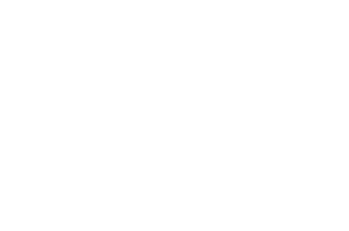

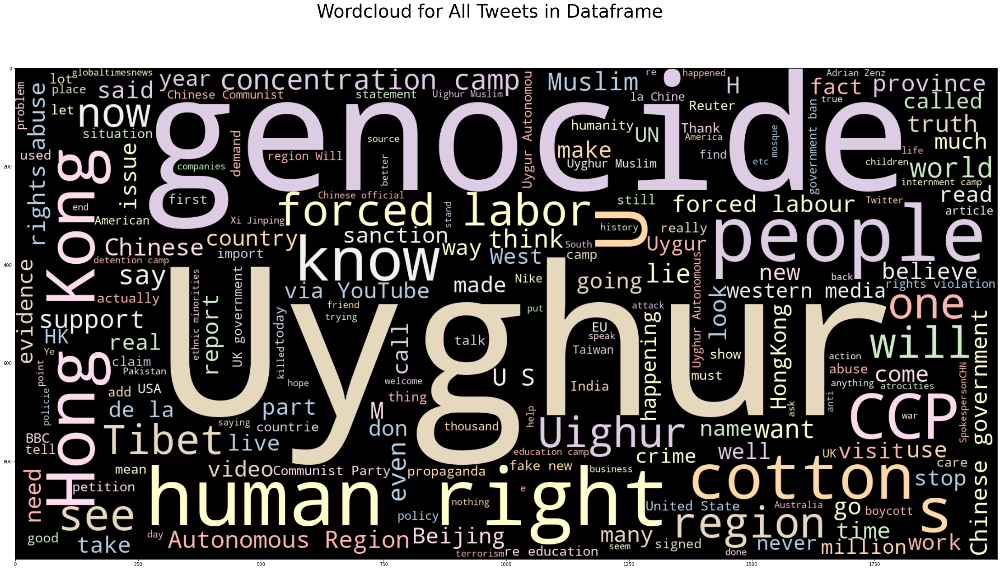

In [9]:
## wordcloud from tweets
# source: https://re-thought.com/creating-wordclouds-in-python/

# text of all words in column tweet

text = " ".join(tweet for tweet in tweets.tweet.astype(str))
print ("There are {} words in the combination of all cells in column 'tweet'.".format(len(text)))

# Create stopword list:
# remove words that we want to exclude

stopwords = set(STOPWORDS)
stopwords.update(["https", "t", "co", "amp", "Xinjiang", "China"])

# Generate a word cloud image

wordcloud = WordCloud(stopwords=stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure(figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for All Tweets in Dataframe', fontsize=40)
plt.show()

wordcloud.to_file("Graphs/wordcloud_total.png")
#exported

There are 38575037 words in the combination of all cells in column 'tweet'.


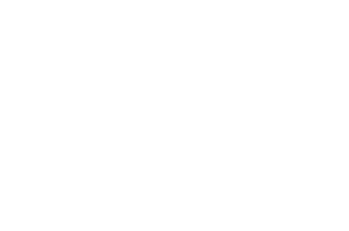

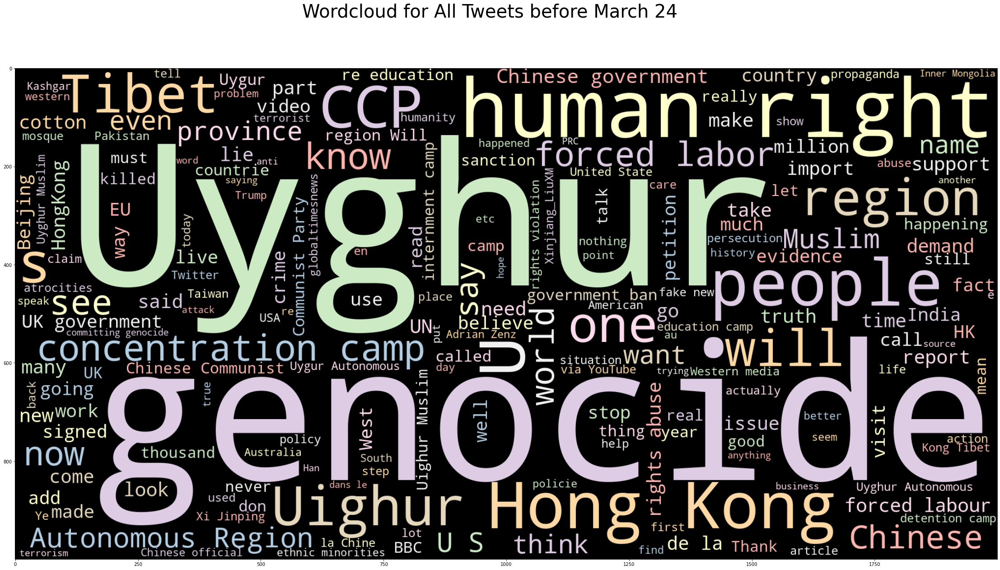

In [10]:
# wordcloud from tweets before March 24

mask = (tweets['date'] < '2021-3-24')
tweets.loc[mask]

text = " ".join(tweet for tweet in tweets.loc[mask].tweet.astype(str))
print ("There are {} words in the combination of all cells in column 'tweet'.".format(len(text)))

# Create stopword list:
# remove words that we want to exclude

stopwords = set(STOPWORDS)
stopwords.update(["https", "t", "co", "amp", "Xinjiang", "China"])


# Generate a word cloud image

wordcloud = WordCloud(stopwords=stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for All Tweets before March 24', fontsize=40)
plt.show()

wordcloud.to_file("Graphs/wordcloud_pre_march24.png")
#exported

There are 20160990 words in the combination of all cells in column 'tweet'.


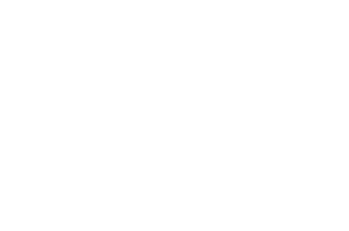

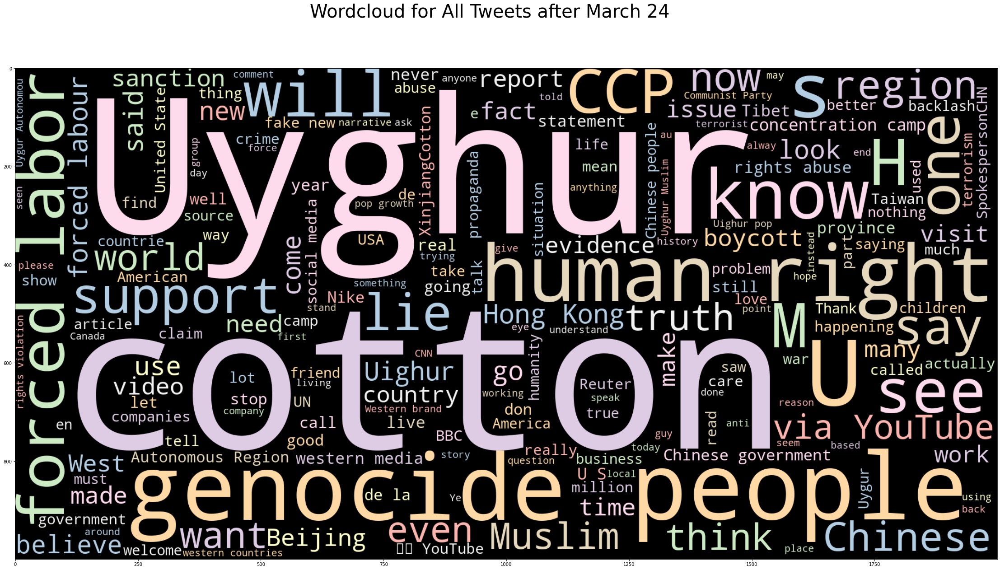

In [11]:
# wordcloud from tweets after March 24

mask = (tweets['date'] > '2021-3-24')
tweets.loc[mask]

text = " ".join(tweet for tweet in tweets.loc[mask].tweet.astype(str))
print ("There are {} words in the combination of all cells in column 'tweet'.".format(len(text)))

# Create stopword list:
# remove words that we want to exclude

stopwords = set(STOPWORDS)
stopwords.update(["https", "t", "co", "amp", "Xinjiang", "China"])


# Generate a word cloud image

wordcloud = WordCloud(stopwords=stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for All Tweets after March 24', fontsize=40)
plt.show()

wordcloud.to_file("Graphs/wordcloud_post_march24.png")
#exported

In [22]:
# see if there are any common sources for all tweets
tweets_usercounts = tweets['username'].value_counts()
print(tweets_usercounts.head(20))

# # see if there are any common sources for support tweets
# support_tweets_usercounts = support_tweets['username'].value_counts()
# print(support_tweets_usercounts.head(20))

sinbad_w           875
hker20682966       771
deepadiver2        759
zhangfei987611     644
insulaew           634
globaltimesnews    604
amyr___9090        603
butterflyserend    591
kameyamatikusei    574
zhang_heqing       552
jerry_grey2002     535
biswadipjana2      533
ngnhtr6            512
barbadostenny      495
xhnews             476
gulnarnorthwest    476
chinadaily         474
pppongo            465
williamyang120     450
marcust95181887    426
Name: username, dtype: int64


In [23]:
# create df of all tweets containing the word genocide
genocide_tweets = tweets[tweets["tweet"].str.contains("genocide")]

pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
genocide_tweets[["tweet", "name", "date"]]

,tweet,name,date
0,"you would think by the comments and qts he's platforming some kind of monstrous nazbol holocaust denier type. but it's just Bay Area ML and the ""genocide"" in question being denied is xinjiang lmao",CCCP died for p'zones,2021-04-28
3,@EmilLaske @_SecondThought physical genocide? where's the refugee crisis? why were uyghurs exempt for decades from the one-child policy and allowed to have 2-4 kids? cultural? hui are the more majority muslim pop. where's their genocide? what about the uyghurs living in xinjiang denouncing said genocide?,someone's burner account,2021-04-28
19,"@LodzTA @El_Ari00 @The_Hectisch @_SecondThought despite xinjiang only consists of less than 1% of the population, the gov had sent tons of resources to preserve the culture in xinjiang. and you are telling me there's a culture genocide in there?",DongsMBM,2021-04-28
22,"@LodzTA @El_Ari00 @The_Hectisch @_SecondThought imagine...imagine that you can literally fly to xinjiang and walk around, talk to uyghurs, etc. and see that they're literally still practicing islam...? or how about the Hui who are also muslim and have a higher pop. than uyghurs...practicing islam? where's their genocide?",someone's burner account,2021-04-28
34,New Zealand Parliament may debate whether China is committing acts of genocide against the Uighur people in Xinjiang. https://t.co/rLfFpApzEO,Umair Akbar,2021-04-28
...,...,...,...
310710,I probably annoy y’all with my tweets about China &amp; the *ongoing* mass detention/genocide in Xinjiang - It’s hard to imagine the scale of what’s happening So ignore my words &amp; take a couple mins to go through this interactive: https://t.co/kefUYsAEbv We all need to see it,Teej,2020-09-24
310807,"""#Xinjiang’s coercive labor program... is being applied to #Tibet as part of #XiJinping's pursuit of #China's ongoing #cultural #genocide in Tibet — compelling reason to support the campaign to #FreeTibet from the #PRC's brutal #dictatorship~! https://t.co/1JXcBkeUNa",Pauline Park,2020-09-24
310822,"George Clooney apparently spent all of his Nespresso money on buying satellite imagery to track the genocide in Dafur, Sudan. If any celebrity wants to do the same with Xinjiang I'm always happy to help! (or if you just want a briefing, as James offered in the OG tweet).",Nathan Ruser,2020-09-24
310917,"Even they named as ""Educational"", ""Occupational"" or ""physical"", we all know that is prison. #ccp campaign in #Xinjiang, #innermongolia, #tibet of #genocide.",Conscience-良知,2020-09-24


In [13]:
# see if there are any common sources for all tweets
tweets_usercounts = tweets['username'].value_counts()
print(tweets_usercounts.head(20))

# see if there are any common sources for genocide tweets
# genocide_tweets_usercounts = support_tweets['username'].value_counts()
# print(genocide_tweets_usercounts.head(20))

sinbad_w           875
hker20682966       771
deepadiver2        759
zhangfei987611     644
insulaew           634
globaltimesnews    604
amyr___9090        603
butterflyserend    591
kameyamatikusei    574
zhang_heqing       552
jerry_grey2002     535
biswadipjana2      533
ngnhtr6            512
barbadostenny      495
gulnarnorthwest    476
xhnews             476
chinadaily         474
pppongo            465
williamyang120     450
marcust95181887    426
Name: username, dtype: int64


## 2. Sentiment Analysis

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import json
import numpy as np

In [ ]:
big_df = pd.read_csv("CSVs/tweets.csv")

In [ ]:
big_df.head()

In [ ]:
hashtag_df = pd.DataFrame()

In [ ]:
result = [row for row in big_df['tweet'] if "#XinjiangCotton" in row]

In [ ]:
new_hashtag_df = hashtag_df.append(result)

In [ ]:
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

In [ ]:
new_hashtag_df.columns = ['tweet']

In [ ]:
no_hashtag_df = pd.DataFrame()

In [ ]:
result2 = [row for row in big_df['tweet'] if not '#XinjiangCotton' in row]

In [ ]:
nono_hashtag_df = no_hashtag_df.append(result2)

In [ ]:
nono_hashtag_df.columns = ['tweet']

In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
analyser = SentimentIntensityAnalyzer()

In [ ]:
big_df['compound'] = [analyser.polarity_scores(x)['compound'] for x in big_df['tweet']]
big_df['neg'] = [analyser.polarity_scores(x)['neg'] for x in big_df['tweet']]
big_df['neu'] = [analyser.polarity_scores(x)['neu'] for x in big_df['tweet']]
big_df['pos'] = [analyser.polarity_scores(x)['pos'] for x in big_df['tweet']]

In [ ]:
big_df['compound'].mean()

In [ ]:
big_df['neg'].mean()

In [ ]:
big_df['neu'].mean()

In [ ]:
big_df['pos'].mean()

In [ ]:
new_hashtag_df['compound'] = [analyser.polarity_scores(x)['compound'] for x in new_hashtag_df['tweet']]
new_hashtag_df['neg'] = [analyser.polarity_scores(x)['neg'] for x in new_hashtag_df['tweet']]
new_hashtag_df['neu'] = [analyser.polarity_scores(x)['neu'] for x in new_hashtag_df['tweet']]
new_hashtag_df['pos'] = [analyser.polarity_scores(x)['pos'] for x in new_hashtag_df['tweet']]

In [ ]:
new_hashtag_df['compound'].mean()

In [ ]:
new_hashtag_df['neg'].mean()

In [ ]:
new_hashtag_df['neu'].mean()

In [ ]:
new_hashtag_df['pos'].mean()

In [ ]:
nono_hashtag_df['compound'] = [analyser.polarity_scores(x)['compound'] for x in nono_hashtag_df['tweet']]
nono_hashtag_df['neg'] = [analyser.polarity_scores(x)['neg'] for x in nono_hashtag_df['tweet']]
nono_hashtag_df['neu'] = [analyser.polarity_scores(x)['neu'] for x in nono_hashtag_df['tweet']]
nono_hashtag_df['pos'] = [analyser.polarity_scores(x)['pos'] for x in nono_hashtag_df['tweet']]

In [ ]:
nono_hashtag_df['compound'].mean()

In [ ]:
nono_hashtag_df['neg'].mean()

In [ ]:
nono_hashtag_df['neu'].mean()

In [ ]:
nono_hashtag_df['pos'].mean()

In [ ]:
nono_hashtag_df

In [ ]:
# create df for tweets using Xinjiang cotton hashtag
yes_hash = new_hashtag_df.groupby([True]*len(new_hashtag_df)).agg('mean')
yes_hash.index = ['Tweets Using #Xinjiang Cotton']
yes_hash

In [ ]:
# create df for tweets not using Xinjiang cotton hashtag
no_hash = nono_hashtag_df.groupby([True]*len(nono_hashtag_df)).agg('mean')
no_hash.index = ['Tweets Not Using #Xinjiang Cotton']
no_hash

In [ ]:
# create df for tweets not using Xinjiang cotton hashtag
sentiment_all = big_df[["compound", "neg", "neu", "pos"]]
all_tweets = sentiment_all.groupby([True]*len(sentiment_all)).agg('mean')
all_tweets.index = ['All Tweets']
all_tweets

In [ ]:
# create df comparing sentiment scores for tweets with and without #Xinjiang Cotton
intermediate = all_tweets.append(yes_hash)
sentiment = intermediate.append(no_hash)
sentiment

In [ ]:
ax = sns.barplot(x="day", y="total_bill", hue="sex", data=tips)

In [ ]:
labels = ['Compound', 'Negative', 'Neutral', 'Positive']
all_means = [-.155739, .102724, .836453, .060823]
hash_means = [.023205, .066690, .850901, .082406]
nohash_means = [-.185324, .108681, .834064, .057254]

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

# plot data in grouped manner of bar type
plt.bar(x-0.2, all_means, width, color='darkgreen')
plt.bar(x, hash_means, width, color='firebrick')
plt.bar(x+0.2, nohash_means, width, color='steelblue')
plt.xticks(x, ['Compound', 'Negative', 'Neutral', 'Positive'])
plt.ylabel('Sentiment Scores')
plt.legend(["All Tweets", "Tweets Using #XinjiangCotton", "Tweets Not Using #XinjiangCotton"])
plt.show()

In [ ]:
mean_grouped = big_df.groupby('date')['compound'].mean() 
#convert to df
df_mean_grouped = mean_grouped.to_frame()



In [ ]:
big_df['date'] = pd.to_datetime(big_df['date'])

tweets_date = big_df.sort_values('date').set_index('date')

#groups the data by weeks to avoid overcrowding
sent_by_week = tweets_date['compound'].resample('W').mean()

ax = sent_by_week.plot(kind='bar', figsize=(25,10), legend=None, color='cornflowerblue')
plt.xlabel('Date', fontsize=16)
plt.ylabel('Compound Sentiment Score', fontsize=16)
plt.title('Compound Sentiment Score by Week', fontsize=24)


# make the week labels have the first day of the week
ax.set_xticklabels(sent_by_week.index.strftime('%Y-%m-%d'), rotation=90)

In [ ]:
tweets

In [ ]:
tweets['compound'] = [analyser.polarity_scores(x)['compound'] for x in tweets['tweet']]
tweets['neg'] = [analyser.polarity_scores(x)['neg'] for x in tweets['tweet']]
tweets['neu'] = [analyser.polarity_scores(x)['neu'] for x in tweets['tweet']]
tweets['pos'] = [analyser.polarity_scores(x)['pos'] for x in tweets['tweet']]

In [ ]:
tweets['hashtag'] = False
tweets.info()

In [ ]:
tweets.loc[tweets['tweet'].str.contains("#XinjiangCotton"),'hashtag'] = True

In [ ]:
sns.barplot(x = 'hashtag',
            y = 'fare',
            hue = 'class',
            data = df,
            estimator = np.median,
            ci = 0)

## 3. Manual checks

Analyze Xinjiang tweets located (roughly) in China from start of incident to the present
Shows why manual checks are important in social media analysis

In [ ]:
import twint
import pandas as pd
import nest_asyncio
nest_asyncio.apply()

In [ ]:
#set coordinates for 2000 km radius around center of China
#not perfect but a rough place to start

c = twint.Config()
c.Search = 'Xinjiang'
c.Lang = 'en'
c.Geo = "35.861694,104.195389,2000km"
c.Pandas = True
c.Since = '2021-03-25'
c.Until = '2021-04-26'
c.Hide_output = True

twint.run.Search(c)

In [ ]:
df = twint.storage.panda.Tweets_df

In [ ]:
df.shape

In [ ]:
!pip install wordcloud

import matplotlib.pyplot as plt
import datetime
import numpy as np
from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [ ]:
#making a wordcloud
# source: https://re-thought.com/creating-wordclouds-in-python/

# text of all words in column tweet

text = " ".join(tweet for tweet in df.tweet.astype(str))
print ("There are {} words in the combination of all cells in column 'tweet'.".format(len(text)))

#create stopwords, remove xinjiang (it's in every tweet by definition of tweepy search) and china

stopwords = set(STOPWORDS)
stopwords.update(["https", "t", "co", "amp", "Xinjiang", "China", 'Uyghur', 'Chinese', 'people'])

# Generate a word cloud image

wordcloud = WordCloud(stopwords=stopwords, background_color="white", width=800, height=400).generate(text)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for All Tweets in Dataframe', fontsize=40)
plt.show()

In [ ]:
#noticed make rumors is pretty prominent
#store text from all tweets with rumor in a variable

rumors = " ".join(tweet for tweet in df.tweet.astype(str) if "rumors" in tweet)

In [ ]:
print(rumors)
#turns out it's mostly one person spamming reply tweets
#this is why you can't only do automated analysis

In [ ]:
wubaowei_df = df[df["username"].str.contains("wubaowei")]

wubaowei_df[["tweet", "username","name", "date"]]

In [ ]:
#check it against another word
#this one doesn't look like it's filled with spam
propaganda = " ".join(tweet for tweet in df.tweet.astype(str) if "propaganda" in tweet)

In [ ]:
print(propaganda)

## 4. Adding state-affiliated marker

In [3]:
#from this site: https://www.whatsonweibo.com/the-prc-twitter-list-the-rise-of-china-on-twitter/
#from Matt DeButts on Twitter

state_aff = ['CathayPak', 'EmbaixadaChina', 'ChnEmbassy_jp', 'ChineseEmbinUS', 'Chinamission2un', 
             'AmbCina', 'ChinaEmbEsp', 'ChinaEmbTurkey', 'AmbassadeChine', 'ChineseEmbtoYEM', 'ChinaEUMission', 
             'ChineseEmbinUK', 'Chinaembmanila', 'ChineseEmbSA', 'ChineseEmbKenya', 'ChinaEmbOttawa', 'ChineseEmbTZ', 
             'ChineseZimbabwe', 'chinaconsulist', 'AmbCHINEenRDC', 'ChineseEmb_Uga', 'Emb_ChinaVen', 'ChineseSomalia', 
             'ChinaEmbArg', 'ChinaEmbSL', 'ChinaEmbAddis', 'ChinaMissionGva', 'ChineseEmbinHU', 'ChinaMissionVie', 
             'ChinaEmbGermany', 'ChinaConsulate', 'ambchinetchad', 'ChinaIraq', 'ChinaEmbIreland', 'ChinaEmbPoland', 
             'ChinaEmbGrenada', 'ChinaEmbKazakh', 'AmbChineBurundi', 'chine_guinee', 'ChinaEmSlovenia', 'Chine_au_Mali', 
             'ChinaCGCalgary', 'chinaembaustria', 'china_embajada', 'ChineseembassyJ', 'ChinaEmbAngola', 'ChineseEmb_PNG', 
             'chinaandsamoa', 'ChineseLiberia', 'AmbChineCmr', 'ConsulChinaRJ', 'ChnConsulateNgo', 'ChinaembassyT', 
             'ZhongBai2020', 'ConsulChinaBcn', 'china_emb_ng', 'ChinaInDenmark', 'ChinaEmbSVK', 'ChinaEmbPeru', 
             'CHNEmbSuriname', 'ChnConsulateNgt', 'jejuZLG', 'CGPRCinDubai', 'ChnConsulateFuk', 'ChineseEmbinRus', 
             'embassy_chinese', 'ChineseEmbinCZ', 'ChinaEmbinGH', 'ChineAmbDjibout', 'China_Lyon', 'ChinaEmbNL', 
             'ChnConsulateJhb', 'ChinaConSydney', 'EmbChina_RS', 'consulat_de', 'ConsulateSan', 'chinacgedi', 
             'CCGBelfast', 'AmbCuiTiankai', 'China_Amb_India', 'AmbLiuXiaoMing', 'WanmingYang', 'PRCAmbNepal', 
             'AmbChenWeiQing', 'AmbChangHua', 'weiasecas', 'zhang_heqing', 'EmbZhangRun', 'AmbassadorZhang', 
             'ChinaEmbKabul', 'li_xiaosi', 'China2ASEAN', 'AmbChenBo', 'ZhaLiyou', 'Xiaodong_Mu', 'Amb_Yiming', 
             'China_Amb_Zim', 'AmbLiaoLiqiang', 'libijian2', 'ChinaSpox_India', 'AmbLiuQuan', 'ChinainLebanon', 
             'LiyingZHU1', 'oujianhong', 'AmbFengBiao', 'AmbLiuGuangYuan', 'PRCAmbNL', 'Amb_ZhuJing', 'Amb_ChenXu', 
             'ChinaAmbUN', 'Ambassador_Liu', 'DrZhaoyongchen', 'AmbassadorHuang', 'CAOYI170610', 'CGZhangPingLA', 
             'Dong_zhihua', 'CGCHINA_CPT', 'ChinaAmbBelgium', 'LiuHongyang4', 'ChinaAmbUganda', 'AmbassadeurLiLi', 
             'Dr_ZhaoQinghua', 'CGChinaLiYang', 'YXiusheng', 'chineseembassy1', 'FangYi85320692', 'GuWenliang', 
             'xing_lijun', 'AmbassadorLei', 'AmbZhouJian', 'Amb_LiSong', 'GeneralkonsulDu', 'RibiaoChen', 'Song_Chq', 
             'WDonghua', 'CHN_EGY', 'YichuSong', 'CGMeifangZhang', 'ChnMission', 'zlj517', 'SpokespersonCHN', 'MFA_China', 
             'chinascio', 'SpokespersonHZM', 'cidcaofficial', 'FuCong17', 'CGTNOfficial', 'XHNews', 'PDChina', 
             'ChinaDaily', 'hongfenghuang', 'globaltimesnews', 'HuXijin_GT', 'XinhuaChinese', 'chinaorgcn', 'wangxh65', 
             'CCTV', 'CGTNFrancais', 'ChinaScience', 'PDChinaBusiness', 'PDChinaLife', 'ChinaPlusNews', 'PDChinese', 
             'cgtnarabic', 'XHSports', 'Echinanews', 'cgtnenespanol', 'XinhuaTravel', 'CNS1952', 'FlyOverChina', 
             'shanghaidaily', 'cgtnamerica', 'yicaichina', 'Guangming_Daily', 'PuebloEnLnea', 'cgtnafrica', 'PeopleArabic', 
             'XHespanol', 'CPEC_Official', 'BeijingReview', 'french_renmin', 'CriFrancais', 'sixthtone', 'XHJapanese', 
             'XHNorthAmerica', 'peopledailyJP', 'ShanghaiEye', 'ChinaDailyAsia', 'CCTV_plus', 'RenminDeutsch', 
             'Chinacultureorg', 'CRIjpn', 'loveqingdao', 'GlobalTimes_CN', 'XHChineNouvelle', 'XHMyanmar', 'XHportugues', 
             'GlobalTimesBiz', 'ChinaDailyEU', 'chenweihua', 'XHSwahili', 'XHSwahili', 'CGTNEurope', 'thepapercn', 
             'cctvarabic', 'XHdeutsch', 'XHRomania', 'GlobalTimesRus', 'GlobalTimesLife', 'WorldInsight_TW', 
             'womenofchina', 'PeoplesDailyapp', 'CDHKedition', 'China24Official', 'CDAfricaNews', 'ChinaDailyUSA', 
             'CD_visual', 'germanchinaorgc', 'xinhua_africa', 'ChinaDailyWorld.', 'GlobalWatchCGTN', 'PDChinaHK', 
             'ChinaDaily_Life', 'CGTN_Culture', 'CGTNTech', 'CGTNStories', 'CdOpinion', 'Chinadaily_CH', 'chinadailyrus', 
             'ChinaDaily_EU', 'ChinaYouthOL', 'ChinaEmbAntigua', 'chengjiny', 'DrZhaoYanbo', 'AmbDongXiaojun', 'ErwenXu',
             'AmbassadorLiu', 'AmbassadorXing', 'ZhifeiShen', 'YDunhai', 'AmbNong', 'AmbSomQinjian', 'AmbCHENXiaodong',
             'AmbFangQiu', 'Li_Baorong', 'chinaembcongobz', 'EmbChinaCuba', 'ChinaEmbajadaRD', 'EmbajadaChinaEc', 
             'EmbajadaChinaSV', 'EmbChinaGE', 'ChineseEmb_FJ', 'ChinaEmbFinland', 'Chinaemb_Hellas', 'ChnConsul_osaka', 
             'ChinaEmbKuwait', 'ChinaEmbLesotho', 'ChinaEmbassy_MW', 'ChinaEmbMalta', 'ChinaEmbinMR', 'ChineseEmbinMNE', 
             'ChinaEmbOman', 'ChinaEmbKSA', 'ChineAmbassade', 'China_Ukraine_', 'China_OPCW']

In [4]:
#add new True/False column for if username is in above list
tweets['state_affiliated'] = tweets['username'].isin(state_aff)

In [14]:
# simple stats to see proportion of state affiliated tweets
tweets['state_affiliated'].value_counts()

False    308637
True       2377
Name: state_affiliated, dtype: int64

In [ ]:
#check to make sure it shows up on the far right
tweets

## 5. Find top bigrams and trigrams for state accounts

In [15]:
import nltk
from nltk import FreqDist
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords 
from string import punctuation

In [16]:
# creating two sub-dfs just to convert to string, won't be using for analysis

# state affiliated tweets
state_tweets = tweets[tweets["state_affiliated"] == True]

# non-state affiliated tweets
nonstate_tweets = tweets[tweets["state_affiliated"] == False]

In [17]:
# graph frequency if state affiliated tweets over time
fig = px.bar(state_tweets.groupby('date')['tweet'].count(),
            labels=dict(date="Day", value="Number of Tweets"),
            title="Frequency of State-affiliated Tweets Over Time")
fig.layout.template = 'plotly_dark'
fig.show()
# spike in tweets on 3/25

fig.write_image("Graphs/state_affiliated_frequency.png", scale=5)
#exported

In [18]:
# create strings containing all words for state and non-state tweets
# state-affiliated
state_string = " ".join(tweet for tweet in state_tweets.tweet.astype(str))

# non-state-affiliated
nonstate_string = " ".join(tweet for tweet in nonstate_tweets.tweet.astype(str))

In [ ]:
print(state_string)

In [19]:
stopwords = nltk.corpus.stopwords.words('english')
new_stopwords = ['https', ':', '\'', '?', '@', '.', ',', '#', '&', 'amp', ';', '\'s', 'xinjiang',
                'uygur', 'northwest', 'nw', 'co', 'china', "''", '``', '’', '“', '”']
# can discuss which words to include in stopwords
french_stopwords = nltk.corpus.stopwords.words('french')
spanish_stopwords = nltk.corpus.stopwords.words('spanish')

stopwords.extend(french_stopwords)
stopwords.extend(spanish_stopwords)
stopwords.extend(new_stopwords)
stopwords.extend(list(punctuation))
# tweets from other languages were throwing it off

print(stopwords)

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [20]:
state_tokens = nltk.tokenize.word_tokenize(state_string)
clean_state_tokens = []

for word in state_tokens:
    if not word.lower() in stopwords:
        clean_state_tokens.append(word)

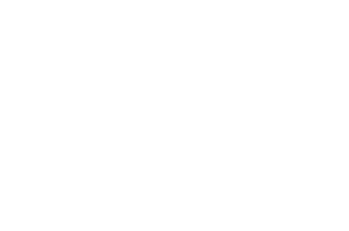

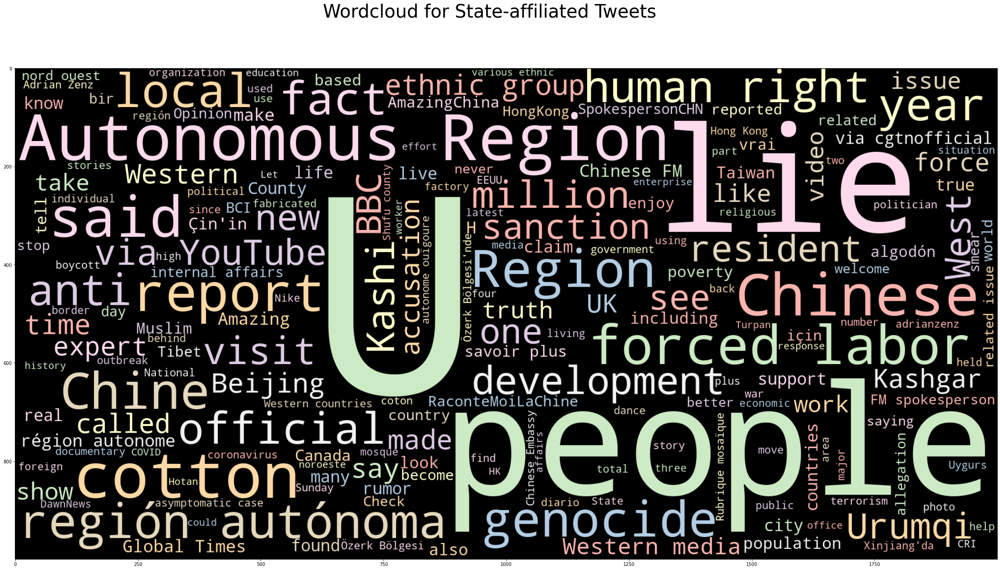

In [21]:
# Generate a word cloud image

wordcloud = WordCloud(stopwords = stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(state_string)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for State-affiliated Tweets', fontsize=40)
plt.show()

wordcloud.to_file("Graphs/wordcloud_state_affiliated.png")
#exported

[('Chinese', 259), ('US', 169), ('cotton', 167), ('people', 163), ('Autonomous', 152), ('Region', 141), ('said', 140), ('lies', 132), ('labor', 120), ('forced', 116), ('Western', 115), ('via', 109), ('región', 105), ('region', 101), ('media', 98), ('Özerk', 96), ('Chine', 92), ('genocide', 91), ('ethnic', 86), ('autónoma', 84), ('local', 77), ('Kashi', 75), ('rights', 73), ('so-called', 72), ('countries', 71), ('new', 70), ('life', 67), ('issues', 67), ('report', 67), ('groups', 62), ('human', 62), ('million', 59), ('spokesperson', 59), ('YouTube', 58), ('development', 58), ('Urumqi', 58), ('Beijing', 55), ('made', 55), ('FM', 55), ('residents', 54), ('COVID19', 54), ('visit', 53), ('one', 53), ('BBC', 53), ('cases', 52), ('West', 51), ('sanctions', 51), ('anti-China', 50), ('poverty', 50), ('cgtnofficial', 50)]


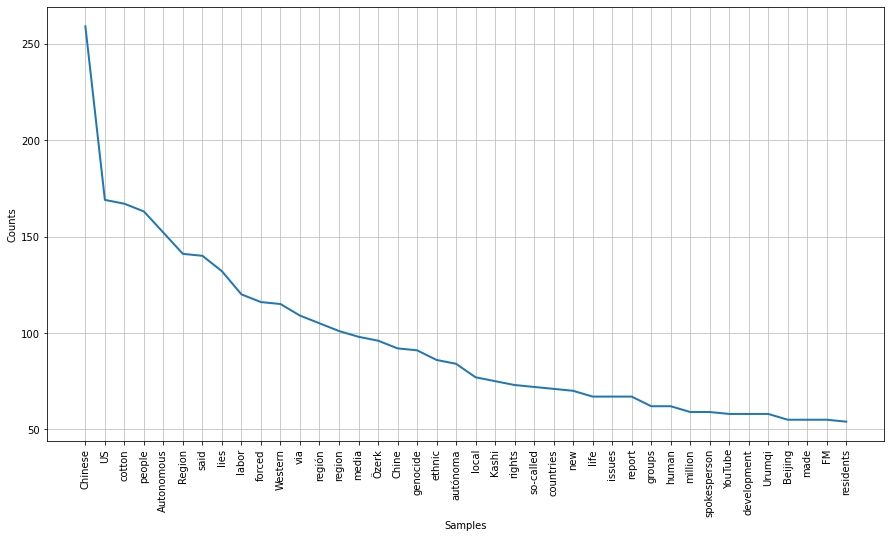

AxesSubplot(0.125,0.125;0.775x0.755)


In [22]:
# most common words
words = nltk.FreqDist(clean_state_tokens)
print(words.most_common(50))
plt.figure(figsize=(15, 8))
print(words.plot(40))

#not exported

C:\Users\Libby\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning:

Glyph 12304 missing from current font.

C:\Users\Libby\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning:

Glyph 26469 missing from current font.

C:\Users\Libby\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning:

Glyph 33258 missing from current font.

C:\Users\Libby\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning:

Glyph 12304 missing from current font.

C:\Users\Libby\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning:

Glyph 26469 missing from current font.

C:\Users\Libby\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning:

Glyph 33258 missing from current font.



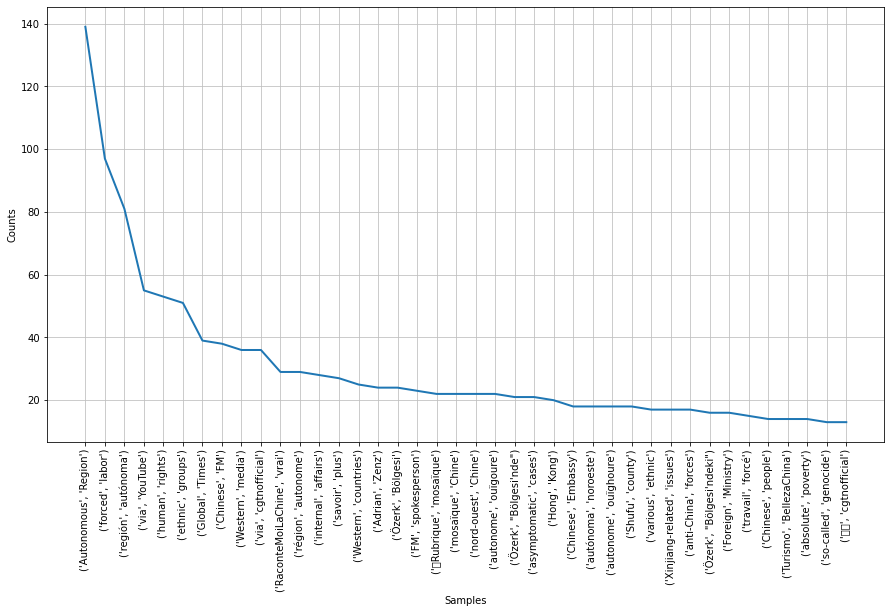

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [24]:
# most common bigrams
bi_state_tokens = list(nltk.bigrams(clean_state_tokens))
bi_freq = FreqDist(bi_state_tokens)

plt.figure(figsize=(15, 8))
bi_freq.plot(40)
#plot the 40 most common

#not exported

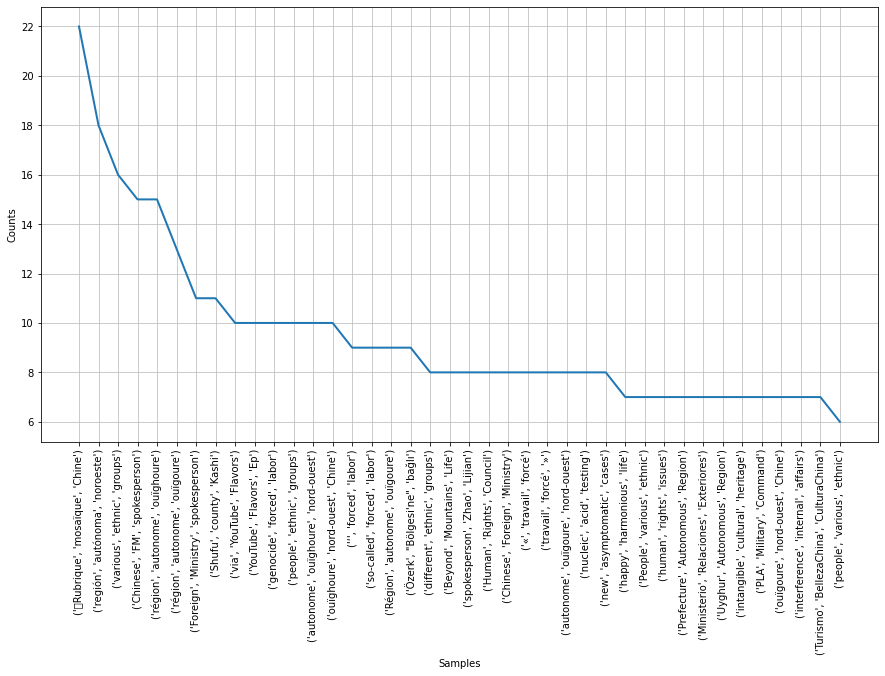

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [25]:
# most common trigrams
tri_state_tokens = list(nltk.trigrams(clean_state_tokens))
tri_freq = FreqDist(tri_state_tokens)
plt.figure(figsize=(15, 8))
tri_freq.plot(40)

#don't need to export this one

## Results of interest:

"Forced labor" with quotes
"Genocide" with quotes
Western media
Ethnic groups?
China internal affairs

We may want to do a subsample of post 3/25?

## 6. Add pro-CCP marker

In [ ]:
tweets

In [5]:
# start with the fact that all state affiliated accounts are pro CCP
tweets['pro_ccp'] = tweets['state_affiliated']
tweets['pro_ccp'].value_counts()

False    308637
True       2377
Name: pro_ccp, dtype: int64

In [6]:
# add conditions based on words
tweets.loc[tweets['tweet'].str.contains('"genocide"', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('"forced labor"', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('western media', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('so-called', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('internal affairs', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('ethnic groups', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains(' lie ', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains(' lies', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('accusation', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('smear', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('terrorism', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('stabilize', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

# removed adrian zenz

# adding a few we saw in our original dfs
tweets.loc[tweets['tweet'].str.contains('no evidence', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

# changed from 'no hard evidence' to 'hard evidence' (saw 'zero hard evidence a couple of times')
tweets.loc[tweets['tweet'].str.contains('hard evidence', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('rumor', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

# saw this one in the word cloud
tweets.loc[tweets['tweet'].str.contains('amazing', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

# from looking through the old anti-ccp list
tweets.loc[tweets['tweet'].str.contains('allege', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('the west', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains(' plot', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('unverified', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('debunk', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('slander', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

#to get deradicalize, deradicalizing and deradicalization
tweets.loc[tweets['tweet'].str.contains('deradicaliz', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('malicious', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('sabotage', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

#to get extremist/extremism
tweets.loc[tweets['tweet'].str.contains('extremis', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains('no genocide', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains(' bias', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

#to get fabricate(d) and fabrication/fabricating
tweets.loc[tweets['tweet'].str.contains('fabricat', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

tweets.loc[tweets['tweet'].str.contains(' fake news', case=False), 'pro_ccp'] = True
print(tweets['pro_ccp'].value_counts())

False    306806
True       4208
Name: pro_ccp, dtype: int64
False    306240
True       4774
Name: pro_ccp, dtype: int64
False    303190
True       7824
Name: pro_ccp, dtype: int64
False    301720
True       9294
Name: pro_ccp, dtype: int64
False    301039
True       9975
Name: pro_ccp, dtype: int64
False    300033
True      10981
Name: pro_ccp, dtype: int64
False    298740
True      12274
Name: pro_ccp, dtype: int64
False    293616
True      17398
Name: pro_ccp, dtype: int64
False    291974
True      19040
Name: pro_ccp, dtype: int64
False    290907
True      20107
Name: pro_ccp, dtype: int64
False    286317
True      24697
Name: pro_ccp, dtype: int64
False    285760
True      25254
Name: pro_ccp, dtype: int64
False    285200
True      25814
Name: pro_ccp, dtype: int64
False    285073
True      25941
Name: pro_ccp, dtype: int64
False    283084
True      27930
Name: pro_ccp, dtype: int64
False    282385
True      28629
Name: pro_ccp, dtype: int64
False    280654
True      30360
Name: pr

In [25]:
print(tweets['pro_ccp'].value_counts())
#slight discrepancy between above cell and this one? - it was because I did some language filtering at the end
# doing language filtering below instead

False    269865
True      41149
Name: pro_ccp, dtype: int64


In [26]:
# first try: 43971 pro-ccp tweets
# second try with " lie " instead of "lie": 27829 pro-ccp tweets
# third try: 41149 pro-ccp tweets (May 4)

tweets.to_csv('CSVs/tweets_withclassification.csv', index = False)

In [7]:
## Language filtering
# drop all tweets that are not 'en', 'zh', or 'und'
tweets_en = tweets[tweets['language'].isin(['en', 'zh', 'und'])]
print(tweets_en['pro_ccp'].value_counts())

# 39051 pro-ccp tweets after language filtering
# NOTE: from now on use tweets_en
# tweets.to_csv('CSVs/tweets_en.csv', index = False)

False    229803
True      39051
Name: pro_ccp, dtype: int64


In [8]:
pro_ccp_tweets = tweets_en[tweets_en["pro_ccp"] == True]
pro_ccp_tweets.describe()

,id,conversation_id,timezone,user_id,replies_count,retweets_count,likes_count,video,near,geo,source,user_rt_id,user_rt,retweet_id,retweet_date,translate,trans_src,trans_dest
count,3.905100e+04,3.905100e+04,39051.0,3.905100e+04,39051.000000,39051.000000,39051.000000,39051.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,1.363148e+18,1.361461e+18,-400.0,7.666080e+17,1.786228,4.158690,14.562700,0.182966,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,2.014118e+16,2.635805e+16,0.0,5.835347e+17,12.009328,31.283673,100.051746,0.386643,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,1.309281e+18,5.539083e+17,-400.0,1.219100e+04,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,1.353303e+18,1.352085e+18,-400.0,1.547873e+09,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,1.372816e+18,1.372104e+18,-400.0,1.077241e+18,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,1.376953e+18,1.376637e+18,-400.0,1.267929e+18,1.000000,1.000000,3.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,1.387557e+18,1.387557e+18,-400.0,1.386489e+18,1113.000000,2014.000000,9392.000000,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# visual check - not perfect, but headed in the right direction
pro_ccp_tweets[['tweet', 'username']]

In [9]:
anti_ccp_tweets = tweets_en[tweets_en["pro_ccp"] == False]

In [30]:
grouped = tweets_en.groupby(["pro_ccp"]).count().reset_index()
grouped['Count'] = grouped['id']
# plt.figure(figsize=(15, 8))
# ax = grouped.plot(x='pro_ccp', y='Count', kind='bar')
# ax.set_xlabel('Tweets Categorized by Pro and Anti CCP', fontsize=14)
# ax.set_ylabel('Number of Tweets', fontsize=14)
# ax.set_title('Number of Pro and Anti CCP Tweets', fontsize=20)

tweets_en['pro_ccp_str'] = "Anti-CCP"
tweets_en.loc[tweets_en['pro_ccp'] == True, 'pro_ccp_str'] = "Pro-CCP"

fig = px.bar(tweets_en.groupby('pro_ccp_str')['id'].count(),
            labels=dict(pro_ccp_str="Tweets Categorized by Pro and Anti CCP", value="Number of Tweets"),
            title="Number of Pro and Anti CCP Tweets")
fig.layout.update(showlegend = False)
fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/pro_vs_anti_frequency.png", scale=5)
#exported

<ipython-input-30-d8686e86c0d0>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/joshualam/opt/anaconda3/lib/python3.8/site-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Frequency of pro-ccp and non pro-ccp tweets over time

In [31]:
# pro-ccp tweets by month


# plot frequency by month
# plt.figure(figsize = (15, 8))
# pro_ccp_tweets["date"].groupby([pro_ccp_tweets["date"].dt.year, pro_ccp_tweets["date"].dt.month]).count().plot(kind="bar")
# plt.xlabel('Year, Month', fontsize=16)
# plt.ylabel('Number of Tweets', fontsize=16)
# plt.suptitle('Frequency of Pro-CCP Tweets by Month', fontsize=24)

pro_tweets_date = pro_ccp_tweets.sort_values('date').set_index('date')
pro_month_resample = pro_tweets_date['id'].resample('M').count()




fig = px.bar(pro_month_resample,
            labels=dict(date="Month", value="Number of Tweets"),
            title="Frequency of Pro-CCP Tweets by Month")
fig.layout.update(showlegend = False)
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y",
    ticklabelmode="period")
fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/pro_tweets_by_month.png", scale=5)
#exported

In [32]:
# pro-ccp tweets over time
fig = px.bar(pro_ccp_tweets.groupby('date')['tweet'].count(),
            labels=dict(date="Day", value="Number of Tweets"),
            title="Frequency of Pro-CCP Tweets Over Time")
fig.layout.update(showlegend = False)
fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/pro_ccp_by_day.png", scale=5)
#exported

In [33]:
anti_tweets_date = anti_ccp_tweets.sort_values('date').set_index('date')
anti_month_resample = anti_tweets_date['id'].resample('M').count()



fig = px.bar(anti_month_resample,
            labels=dict(date="Month", value="Number of Tweets"),
            title="Frequency of Anti-CCP Tweets by Month")
fig.layout.update(showlegend = False)
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y",
    ticklabelmode="period")
fig.layout.template = 'plotly_dark'
fig.show()


fig.write_image("Graphs/anti_ccp_by_month.png", scale=5)
#exported

In [34]:
fig = px.bar(anti_ccp_tweets.groupby('date')['tweet'].count(),
            labels=dict(date="Day", value="Number of Tweets"),
            title="Frequency of Anti-CCP Tweets Over Time")
fig.layout.update(showlegend = False)
fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/anti_ccp_by_day.png", scale=5)
#exported

In [1]:
# stacked bar shart showing how the proportion of pro-ccp tweets changes over time

# reformat df to get the information we need
tweets_date = tweets_en.groupby(['date', 'pro_ccp']).count()
tweets_date['Count'] = tweets_date['id']
tweets_date = tweets_date.filter(['date', 'pro_ccp', 'Count'])
tweets_date = tweets_date.reset_index()

NameError: name 'pd' is not defined

In [11]:
# add percentage to the above df

tweets_date['day_count'] = tweets_date['Count'].groupby(tweets_date['date']).transform('sum')
tweets_date['Percentage'] = (tweets_date.Count / tweets_date.day_count) * 100
tweets_date

,date,pro_ccp,Count,day_count,Percentage
0,2020-09-24,False,261,283,92.226148
1,2020-09-24,True,22,283,7.773852
2,2020-09-25,False,2358,2482,95.004029
3,2020-09-25,True,124,2482,4.995971
4,2020-09-26,False,1677,1801,93.114936
...,...,...,...,...,...
429,2021-04-26,True,124,973,12.744090
430,2021-04-27,False,975,1154,84.488735
431,2021-04-27,True,179,1154,15.511265
432,2021-04-28,False,791,994,79.577465


In [12]:
# plot stacked bar chart

tweets_date.sort_values(['pro_ccp'],ascending=[False],inplace=True)

fig = px.bar(tweets_date, x = 'date', y = 'Count', 
             color = 'pro_ccp', 
             color_discrete_map={
                 True: '#EF553B',
                 False: '#636EFA'
             },
             barmode = 'stack')

fig.update_layout(title = "Pro- and Anti-CCP Tweets Over Time", 
      xaxis_title = 'Date', yaxis_title =  
      'Number of Tweets')
fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/pro_anti_stacked.png", width=1000, scale=5)
#exported

In [38]:
# plot 100% stacked bar chart

fig = px.bar(tweets_date, x = 'date', y = 'Percentage', color = 
    'pro_ccp', color_discrete_map={
                 True: '#EF553B',
                 False: '#636EFA'
             }, barmode = 'stack')

fig.update_layout(title = "Pro- and Anti-CCP Tweets Over Time as Percentage", 
      xaxis_title = 'Date', yaxis_title =  
      'Percentage of Daily Tweets')

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/pro_anti_stacked_percentage.png", scale=5)
#exported


# conclusion - slight evidence of increased pro-ccp tweets over time?
# what happened on April 7 to cause the small spike in pro-ccp tweets?

## !!! April 7 was the day Twitter announced the #MilkTeaAlliance emoji (https://www.bloomberg.com/news/articles/2021-04-08/twitter-pokes-at-china-with-emoji-supporting-milkteaalliance)

In [47]:
retweet_sums = tweets_en.copy()
retweet_sums['retweet_sum'] = retweet_sums.groupby('username')['retweets_count'].transform('sum')
retweet_sums = retweet_sums.drop_duplicates(subset='username', keep="first")
retweet_sums = retweet_sums.sort_values(by=['retweet_sum'], ascending=False)
retweet_sums.head(20)

,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,...,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,state_affiliated,pro_ccp,retweet_sum
206463,1351580135464558593,1351580135464558593,2021-01-19 12:19:50 EST,2021-01-19,12:19:50,-400,988573326376427520,secpompeo,Secretary Pompeo,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,65544
4193,1386395359770025987,1386395359770025987,2021-04-25 15:03:06 EDT,2021-04-25,15:03:06,-400,1260924545436921858,ipacglobal,Inter-Parliamentary Alliance on China,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,57714
445,1387417012847013888,1387416974389510150,2021-04-28 10:42:47 EDT,2021-04-28,10:42:47,-400,794888669140226048,adrianzenz,Adrian Zenz,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,True,31428
597,1387386931323998214,1387386931323998214,2021-04-28 08:43:15 EDT,2021-04-28,08:43:15,-400,17839398,kenroth,Kenneth Roth,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,25155
155787,1364622262704480262,1364622262704480262,2021-02-24 12:04:35 EST,2021-02-24,12:04:35,-400,9624742,statedept,Department of State,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,22451
2146,1387012692762931205,1387012692762931205,2021-04-27 07:56:10 EDT,2021-04-27,07:56:10,-400,20610385,bueti,Reinhard Bütikofer,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,21146
564,1387392259306311684,1387392259306311684,2021-04-28 09:04:25 EDT,2021-04-28,09:04:25,-400,1183698123719200768,spokespersonchn,Hua Chunying 华春莹,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,True,18729
6773,1385762239903420419,1385762239903420419,2021-04-23 21:07:18 EDT,2021-04-23,21:07:18,-400,1652541,reuters,Reuters,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,15726
85151,1375567415006920709,1375567415006920709,2021-03-26 17:56:43 EDT,2021-03-26,17:56:43,-400,110396781,ajplus,AJ+,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,13237
5141,1386154225877487618,1386154170378428421,2021-04-24 23:04:55 EDT,2021-04-24,23:04:55,-400,1323962901338574848,par1ke,Sarhad Ke Paar,NaN,...,NaN,NaN,[],NaN,NaN,NaN,NaN,False,False,12849


In [49]:
retweet_sums.loc[retweet_sums['username'].str.contains('adrianzenz', case=False), 'pro_ccp'] = False


In [54]:
# plt.figure(figsize = (15, 8))
# tweets.groupby('username')['retweets_count'].sum().sort_values(ascending=False).head(30).plot(kind='bar')
# #which accounts are retweeted most

# plt.xlabel('User', fontsize=14)
# plt.ylabel('Number of Retweets', fontsize=14)
# plt.title('Top Users by Retweets', fontsize=18)

#only SpokespersonCHN is pro-ccp in top 10



fig = px.bar(retweet_sums.head(30), x = 'username', y = 'retweet_sum',
            color='pro_ccp', labels=dict(username="Username", retweet_sum="Number of Retweets"), 
            title="Top 30 Most Retweeted Accounts")
fig.layout.update(showlegend = False)
fig.update_xaxes(categoryorder='total descending')

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/top_30_retweets.png", scale=5)
#exported

In [71]:
# tweet_counts = tweets_en.copy()
# tweet_counts['tweet_counts'] = tweet_counts.groupby('username')['id'].transform('sum')
# tweet_counts = tweet_counts.drop_duplicates(subset='username', keep="first")
# tweet_counts = tweet_counts.sort_values(by=['tweet_counts'], ascending=False)
# tweet_counts.head(20)

tweet_counts = tweets_en.groupby('username')['id'].count()
tweet_counts = tweet_counts.sort_values(ascending=False)
tweet_counts = tweet_counts.head(20).to_frame()
tweet_counts.reset_index(drop=False, inplace=True)

tweet_counts['pro_ccp'] = [False, True, False, False, True, False, True, True, False, True, False, True, 
                           True, True, False, True, False, False, False, True]

tweet_counts.head()


,username,id,pro_ccp
0,sinbad_w,873,False
1,deepadiver2,731,True
2,hker20682966,713,False
3,zhangfei987611,639,False
4,globaltimesnews,598,True


In [74]:
fig = px.bar(tweet_counts, x = 'username', y = 'id',
            color='pro_ccp', labels=dict(username="Username", id="Number of Tweets"), 
            title="Top 30 Most Active Accounts")
fig.layout.update(showlegend = False)
fig.update_xaxes(categoryorder='total descending')

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/top_30_active.png", scale=5)
#exported

In [40]:
# plt.figure(figsize = (15, 8))
# pro_ccp_tweets.groupby('username')['retweets_count'].sum().sort_values(ascending=False).head(10).plot(kind='bar')
# #which accounts are retweeted most

# plt.xlabel('User', fontsize=14)
# plt.ylabel('Number of Retweets', fontsize=14)
# plt.title('Top Pro-CCP Users by Retweets', fontsize=16)

fig = px.bar(pro_ccp_tweets.groupby('username')['retweets_count'].sum().sort_values(ascending=False).head(10),
            labels=dict(username="Username", value="Number of Retweets"),
            title="Top 10 Most Retweeted Pro-CCP Accounts")
fig.layout.update(showlegend = False)

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/top_10_pro_retweets.png", scale=5)
#exported


In [41]:
# plt.figure(figsize = (15, 8))
# anti_ccp_tweets.groupby('username')['retweets_count'].sum().sort_values(ascending=False).head(10).plot(kind='bar')
# #which accounts are retweeted most

# plt.xlabel('User', fontsize=14)
# plt.ylabel('Number of Retweets', fontsize=14)
# plt.title('Top Anti-CCP Users by Retweets', fontsize=18)

fig = px.bar(anti_ccp_tweets.groupby('username')['retweets_count'].sum().sort_values(ascending=False).head(10),
            labels=dict(username="Username", value="Number of Retweets"),
            title="Top 10 Most Retweeted Anti-CCP Accounts")
fig.layout.update(showlegend = False)

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/top_10_anti_retweets.png", scale=5)
#exported

In [42]:
# ## bar graphs of users by number of tweets

# # pro-CCP
# plt.figure(figsize = (15, 8))
# pro_ccp_tweets.groupby('username')['id'].count().sort_values(ascending=False).head(30).plot(kind='bar')
# #which accounts are retweeted most

# plt.xlabel('User', fontsize=14)
# plt.ylabel('Number of Tweets', fontsize=14)
# plt.title('Top Pro-CCP Users by Number of Tweets', fontsize=16)

fig = px.bar(pro_ccp_tweets.groupby('username')['id'].count().sort_values(ascending=False).head(30),
            labels=dict(username="Username", value="Number of Tweets"),
            title="Top 30 Most Active Pro-CCP Accounts")
fig.layout.update(showlegend = False)

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/top_30_active_pro.png", scale=5)
#exported

In [43]:
# ## bar graphs of users by number of tweets

# # anti-CCP
# plt.figure(figsize = (15, 8))
# anti_ccp_tweets.groupby('username')['id'].count().sort_values(ascending=False).head(30).plot(kind='bar')
# #which accounts are retweeted most

# plt.xlabel('User', fontsize=14)
# plt.ylabel('Number of Tweets', fontsize=14)
# plt.title('Top Anti-CCP Users by Number of Tweets', fontsize=16)

fig = px.bar(anti_ccp_tweets.groupby('username')['id'].count().sort_values(ascending=False).head(30),
            labels=dict(username="Username", value="Number of Tweets"),
            title="Top 30 Most Active Anti-CCP Accounts")
fig.layout.update(showlegend = False)

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/top_30_active_anti.png", scale=5)
#exported

In [46]:
pro_ccp_tweets['time']

0         19:59:42
9         19:54:51
12        19:52:18
18        19:43:52
25        19:36:28
            ...   
310982    20:28:28
310984    20:25:31
310988    20:24:03
310995    20:14:47
311013    20:00:00
Name: time, Length: 39051, dtype: object

In [44]:
# convert 'time' string to datetime format
pro_ccp_tweets['time'] = pd.to_datetime(pro_ccp_tweets['time'])
anti_ccp_tweets['time'] = pd.to_datetime(anti_ccp_tweets['time'])


<ipython-input-44-db877f31d009>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-44-db877f31d009>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [45]:
# round time to the nearest hour
pro_ccp_tweets['hour'] = pro_ccp_tweets['time'].dt.round('H').dt.hour
pro_ccp_tweets[['time', 'hour']]

anti_ccp_tweets['hour'] = anti_ccp_tweets['time'].dt.round('H').dt.hour
anti_ccp_tweets[['time', 'hour']]

<ipython-input-45-dbd41156d459>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-45-dbd41156d459>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,time,hour
1,2021-05-04 19:59:37,20
2,2021-05-04 19:59:16,20
3,2021-05-04 19:58:18,20
6,2021-05-04 19:55:50,20
7,2021-05-04 19:54:55,20
...,...,...
311007,2021-05-04 20:04:30,20
311008,2021-05-04 20:03:51,20
311009,2021-05-04 20:03:51,20
311010,2021-05-04 20:00:39,20


In [46]:
# when people post (rounded to nearest hour)
# timezone is UTC (https://twittercommunity.com/t/the-time-appear-in-the-tweets/138349)
fig = px.bar(pro_ccp_tweets.groupby('hour')['tweet'].count())

fig.update_layout(title = "When Pro-CCP Tweets Are Posted", 
      xaxis_title = 'Time (UTC)', yaxis_title =  
      'Number of Tweets')

fig.layout.update(showlegend = False)
fig.layout.template = 'plotly_dark'
fig.show()

# peak = 09:00 UTC
# = 5:00am New York time
# = 5:00pm Beijing time

# trough = 17:00 UTC
# = 1:00pm New York time
# = 1:00am Beijing time

# suggests that pro-CCP tweets mainly originate from a Chinese timezone?

fig.write_image("Graphs/pro_tweet_times.png", scale=5)
#exported

In [47]:
# when people post (rounded to nearest hour)
# timezone is UTC (https://twittercommunity.com/t/the-time-appear-in-the-tweets/138349)
fig = px.bar(anti_ccp_tweets.groupby('hour')['tweet'].count())

fig.update_layout(title = "When Anti-CCP Tweets Are Posted", 
      xaxis_title = 'Time (UTC)', yaxis_title =  
      'Number of Tweets')

fig.layout.update(showlegend = False)
fig.layout.template = 'plotly_dark'
fig.show()

# nevermind, seems like same pattern holds for anti-tweets :/

fig.write_image("Graphs/anti_tweet_times.png", scale=5)
#exported


In [ ]:
anti_ccp_tweets[['tweet', 'username']]

In [ ]:
# exporting anti_ccp_tweets to CSV to help manually identify filter words
anti_ccp_tweets.to_csv('CSVs/anti_ccp_tweets.csv', index=False)

## Adrian Zenz

In [48]:
pro_zenz_tweets = pro_ccp_tweets[pro_ccp_tweets["tweet"].str.contains("zenz")]
pro_zenz_tweets.shape

(353, 39)

In [49]:
pro_zenz_string = ''.join(tweet for tweet in pro_zenz_tweets['tweet'])

In [50]:
zenz_stopwords = ['adrian', 'zenz', 'adrianzenz', 'xinjiang', 'china']
stopwords.extend(zenz_stopwords)

In [51]:
zenz_tokens = nltk.tokenize.word_tokenize(pro_zenz_string)
clean_zenz_tokens = []

for word in zenz_tokens:
    if not word.lower() in stopwords:
        clean_zenz_tokens.append(word)

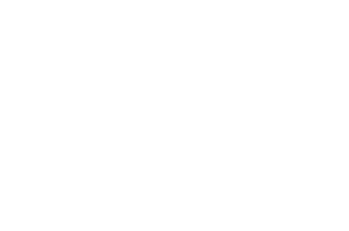

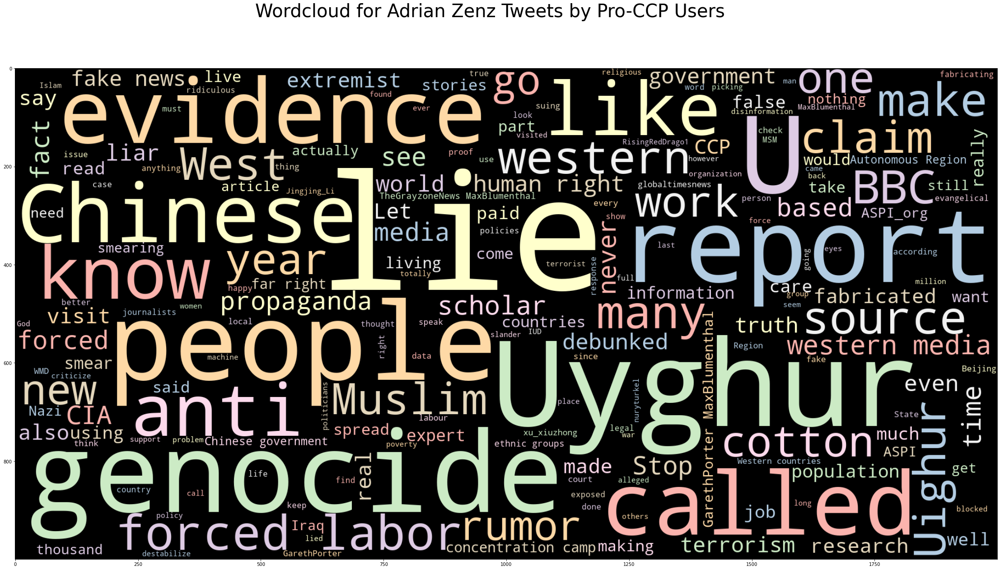

In [52]:
wordcloud = WordCloud(stopwords = stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(pro_zenz_string)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for Adrian Zenz Tweets by Pro-CCP Users', fontsize=40)
plt.show()

#pro-ccp tweets that mention zenz
#super negative overall

wordcloud.to_file("Graphs/pro_ccp_zenz_wordcloud.png")
#exported

In [53]:
anti_zenz_tweets = anti_ccp_tweets[anti_ccp_tweets["tweet"].str.contains("zenz")]
anti_zenz_tweets.shape


(1477, 39)

In [54]:
anti_zenz_string = ''.join(tweet for tweet in anti_zenz_tweets['tweet'])

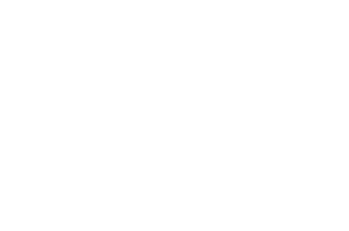

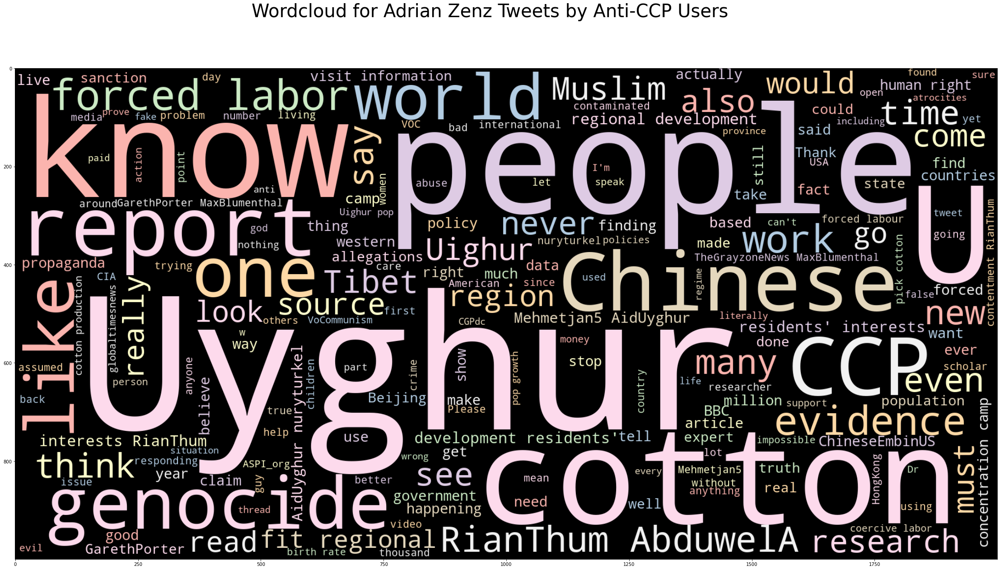

In [55]:
wordcloud = WordCloud(stopwords = stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(anti_zenz_string)

# Display the generated image:
# the matplotlib way:

plt.axis("off")
plt.figure( figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for Adrian Zenz Tweets by Anti-CCP Users', fontsize=40)
plt.show()

#anti-ccp tweets that mention zenz
#much more neutral
#mention lots of other activist accounts

wordcloud.to_file("Graphs/anti_ccp_zenz_wordcloud.png")
#exported

In [56]:
pro_zenz_tweets_usercounts = pro_zenz_tweets['username'].value_counts()
print(pro_zenz_tweets_usercounts.head(10))

anti_zenz_tweets_usercounts = anti_zenz_tweets['username'].value_counts()
print(anti_zenz_tweets_usercounts.head(10))

globaltimesnews    10
risingreddrago1     9
ebzwag7rwaityti     8
obrrobert           7
pnagency            6
deepadiver2         6
zhang_heqing        5
woshuajong          4
aboongm1            4
diemen1111          4
Name: username, dtype: int64
vocommunism        58
smarzeli           20
risingreddrago1    17
justkevooo         16
sigure_ousaka      13
malc_mcgregor      13
newlinesinst       12
imarchmus          11
deepadiver2        11
jerry_grey2002     10
Name: username, dtype: int64


## Links, multimedia, and engagement

In [57]:
#will include youtube and youtu.be urls
youtube_tweets = tweets[tweets['urls'].str.contains('youtu')]


In [58]:
print('Tweets with Youtube links got an average of', youtube_tweets['likes_count'].mean(), 'likes.')
print('Tweets with Youtube links got an average of', youtube_tweets['retweets_count'].mean(), 'retweets.')
print('Tweets as a whole got an average of', tweets['likes_count'].mean(), 'likes.')
print('Tweets as a whole got an average of', youtube_tweets['retweets_count'].mean(), 'retweets.')


Tweets with Youtube links got an average of 4.6851535252684124 likes.
Tweets with Youtube links got an average of 1.5329959652602065 retweets.
Tweets as a whole got an average of 14.933375989505295 likes.
Tweets as a whole got an average of 1.5329959652602065 retweets.


In [59]:
#all tweets that shared a link or had multimedia content
url_tweets = tweets[tweets['urls'] != '[]']


In [83]:
#tons of people are tweeting links
url_tweets.shape

(126148, 38)

In [84]:
print('Tweets with links got an average of', url_tweets['likes_count'].mean(), 'likes.')
print('Tweets with links got an average of', url_tweets['retweets_count'].mean(), 'retweets.')

#looks like tweeting links/multimedia gets a lot more retweet engagement (7 to 1.5)
#tweeting youtube links does not seem to help

Tweets with links got an average of 13.037955417446174 likes.
Tweets with links got an average of 6.980943019310651 retweets.


In [85]:
#coded as 1 if the tweet has an image or video
multimedia_tweets = tweets[tweets['video'] == 1]
multimedia_tweets.shape


(51225, 38)

In [86]:
print('Tweets with directly embedded images and videos got an average of', multimedia_tweets['likes_count'].mean(), 'likes.')
print('Tweets with directly embedded images and videos got an average of', multimedia_tweets['retweets_count'].mean(), 'retweets.')

#this looks like the highest of all engagement
#means it was probably dragging up the url engagement numbers above
#would this be helpful to visualize?

Tweets with directly embedded images and videos got an average of 31.903465104929232 likes.
Tweets with directly embedded images and videos got an average of 12.140966325036603 retweets.


In [70]:
print('Pro-CCP tweets got an average of', pro_ccp_tweets['likes_count'].mean(), 'likes.')
print('Pro-CCP tweets got an average of', pro_ccp_tweets['retweets_count'].mean(), 'retweets.')


Pro-CCP tweets got an average of 14.56270005889734 likes.
Pro-CCP tweets got an average of 4.158689918311951 retweets.


In [71]:
print('Anti-CCP tweets got an average of', anti_ccp_tweets['likes_count'].mean(), 'likes.')
print('Anti-CCP tweets got an average of', anti_ccp_tweets['retweets_count'].mean(), 'retweets.')


Anti-CCP tweets got an average of 15.094567956031906 likes.
Anti-CCP tweets got an average of 6.162547921480573 retweets.


In [87]:
top_pro_languages = pro_ccp_tweets.groupby('language')['id'].count().sort_values(ascending=False)
top_pro_languages.head(10)

language
en     38443
zh       578
und       30
Name: id, dtype: int64

In [88]:
top_anti_languages = anti_ccp_tweets.groupby('language')['id'].count().sort_values(ascending=False)
top_anti_languages.head(10)

#realized the discrepancy is probably because our filters are all for english keywords :(

language
en     220322
zh       6090
und      3391
Name: id, dtype: int64

## Botometer - commented out ones that shouldn't be run again

In [ ]:
import botometer

In [ ]:
#set up botometer and twitter auths

rapidapi_key = "881cb19d4cmsh542a38ef565a7c4p1ce2b1jsn49458538227f"
twitter_app_auth = {
    'consumer_key': 'VAzKQic505LfdQ2992q70ZeDf',
    'consumer_secret': 'SWoqijnlKBdhl6XXpStwjkw2iYPy4PWMMBnSsPRP0Im9Na7QoU',
    'access_token': '1375530313577795585-keMm8K2Clv9yA7G8aZYZuk2q96y7XI',
    'access_token_secret': 'uRhfaF0eJGHKOS1JOlwp04phBnDIoQPbFj2j0XQhzdGb1',
  }
  
bom = botometer.Botometer(wait_on_ratelimit=True,
                          rapidapi_key=rapidapi_key,
                          **twitter_app_auth)





In [ ]:
# pro_users = [row for row in pro_ccp_tweets['username']]
# pro_users1 = ['@' + user for user in pro_users[0:101]]
# print(pro_users1)
# # botometer can only do 100 at a time
# #need to have @s

In [ ]:
# bot_df = pd.DataFrame()
#always append pro ones to this

In [ ]:
# bot_df = pd.read_csv('CSVs/pro_bot_scores.csv')

In [ ]:
# for screen_name, result in bom.check_accounts_in(pro_users1):
#     bot_df = bot_df.append(result, ignore_index=True)
    
#don't run this code when you reopen
#api limits to 200/day

In [ ]:
# bot_df.to_csv('CSVs/pro_bot_scores.csv')

In [ ]:
# bot_df.head(10)

In [ ]:
# anti_users = [row for row in anti_ccp_tweets['username']]
# anti_users1 = ['@' + user for user in anti_users[0:101]]
# print(anti_users1)
# # botometer can only do 100 at a time
# #need to have @s

In [ ]:
# anti_bot_df = pd.DataFrame()

In [ ]:
# for screen_name, result in bom.check_accounts_in(anti_users1):
#     anti_bot_df = anti_bot_df.append(result, ignore_index=True)
    
#don't run this code when you reopen
#api limits to 200/day

In [ ]:
# anti_bot_df = pd.read_csv('CSVs/anti_bot_scores.csv')

In [ ]:
# anti_bot_df.head(10)

In [ ]:
# anti_bot_df.to_csv('CSVs/anti_bot_scores.csv')

# if you need to do anything with these data, open the csv



In [36]:
#getting the top accounts
grouped_pro_ccp = pro_ccp_tweets.groupby('username')['id'].count().sort_values(ascending=False).to_frame()
grouped_pro_ccp.reset_index(inplace=True)
grouped_pro_ccp.head()

#top 100 accounts make up 25% of total pro tweets

,username,id
0,globaltimesnews,604
1,zhang_heqing,552
2,deepadiver2,361
3,ultrascanhumint,279
4,amyr___9090,238


In [37]:
#making username list, moving over to pull data
top_pro_ccp = ['@' + tweet for tweet in grouped_pro_ccp['username']]
print(top_pro_ccp[0:100])

['@globaltimesnews', '@zhang_heqing', '@deepadiver2', '@ultrascanhumint', '@amyr___9090', '@wubaowei', '@libijian2', '@xieqingan111', '@chinaconsulist', '@cgtnofficial', '@zh_baolong', '@risingreddrago1', '@diemen1111', '@mariocavolo', '@davypn', '@echinanews', '@lehoang3018', '@silingwu', '@dihorse37', '@sinbad_w', '@chinadaily', '@xhnews', '@mscamir1', '@xcz1957', '@woshuajong', '@hker20682966', '@deanlee59593965', '@thouse_opinions', '@charles78020456', '@dancdo7', '@pandemictruther', '@jerry_grey2002', '@chinaconsydney', '@geopol2030', '@cgtnamerica', '@mahuichina', '@thinking_panda', '@kristhorn91', '@chineseembinuk', '@tiffany28883', '@chinaorgcn', '@caoyi_mfa', '@neh_australasia', '@chinascio', '@mango_press_', '@twichen', '@tarswilliam', '@chinaplusnews', '@kkman20xx', '@4thepeople15', '@armanhkcn', '@lomicchi', '@heerfei', '@spokespersonchn', '@candle_finder', '@beaudroger', '@fluxmulder', '@sy99178635', '@wtuhzrtfxajtd61', '@1mazeemkhan74', '@leezhongmin', '@andyvermaut', '@i

In [38]:
#getting the top accounts
grouped_anti_ccp = anti_ccp_tweets.groupby('username')['id'].count().sort_values(ascending=False).to_frame()
grouped_anti_ccp.reset_index(inplace=True)
grouped_anti_ccp.head()

#top 100 anti accounts make up 10% of total anti tweets

,username,id
0,sinbad_w,773
1,hker20682966,690
2,zhangfei987611,633
3,insulaew,589
4,kameyamatikusei,574


In [40]:
#making username list, moving over to pull data
top_anti_ccp = ['@' + tweet for tweet in grouped_anti_ccp['username']]
print(top_anti_ccp[0:100])

['@sinbad_w', '@hker20682966', '@zhangfei987611', '@insulaew', '@kameyamatikusei', '@butterflyserend', '@biswadipjana2', '@ngnhtr6', '@barbadostenny', '@jerry_grey2002', '@pppongo', '@gulnarnorthwest', '@marcust95181887', '@leeyn89', '@usausa95348691', '@williamyang120', '@deepadiver2', '@xjlxm4', '@xhnews', '@chinadaily', '@amyr___9090', '@andyvermaut', '@hkkowloon', '@cri_turkish', '@justice4uyghur', '@hunterwolfwang', '@brasil_acabou', '@alarmchina', '@uyghur_fighter', '@silingwu', '@fallin2001', '@kelvinbsp', '@giulioterzi', '@cinahistory', '@heerfei', '@cgtnofficial', '@elena41869008', '@cgtnenespanol', '@arleighfrisco', '@vid_colin', '@sehof', '@frontwheelskid', '@sandubanu', '@adrianzenz', '@nrg8000', '@geopol2030', '@lj681120', '@chinareviewed', '@echinanews', '@risingreddrago1', '@woshuajong', '@cgtnfrancais', '@xhindonesia', '@armanhkcn', '@ambassadechine', '@mariocavolo', '@angelrianna1', '@kenroth', '@coolhea87465135', '@pdchina', '@mscamir1', '@xinjiangchannel', '@baigalii

In [41]:
top_pro_df = pd.read_csv('CSVs/top_pro_bot_scores.csv')
top_anti_df = pd.read_csv('CSVs/top_anti_bot_scores.csv')

#loading bot scores, added columns on the right
#can also use other scores if necessary

In [42]:
top_pro_df.head()

,Unnamed: 0,cap,display_scores,raw_scores,user,overall_score
0,0,"{'english': 0.7983123643488195, 'universal': 0...","{'english': {'astroturf': 0.4, 'fake_follower'...","{'english': {'astroturf': 0.08, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",3.6
1,1,"{'english': 0.7971037475964349, 'universal': 0...","{'english': {'astroturf': 2.2, 'fake_follower'...","{'english': {'astroturf': 0.45, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",2.7
2,2,"{'english': 0.7920317685697057, 'universal': 0...","{'english': {'astroturf': 0.8, 'fake_follower'...","{'english': {'astroturf': 0.15, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",1.8
3,3,"{'english': 0.7989890411370751, 'universal': 0...","{'english': {'astroturf': 1.6, 'fake_follower'...","{'english': {'astroturf': 0.31, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",3.6
4,4,"{'english': 0.7053377817049258, 'universal': 0...","{'english': {'astroturf': 0.6, 'fake_follower'...","{'english': {'astroturf': 0.11, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",1.0


In [43]:
top_anti_df.head()

,Unnamed: 0,cap,display_scores,raw_scores,overall_score
0,0,"{'english': 0.796622208632847, 'universal': 0....","{'english': {'astroturf': 1.2, 'fake_follower'...","{'english': {'astroturf': 0.23, 'fake_follower...",3.1
1,1,"{'english': 0.7968624754031172, 'universal': 0...","{'english': {'astroturf': 3.4, 'fake_follower'...","{'english': {'astroturf': 0.67, 'fake_follower...",3.4
2,2,"{'english': 0.816204310368583, 'universal': 0....","{'english': {'astroturf': 0.3, 'fake_follower'...","{'english': {'astroturf': 0.06, 'fake_follower...",4.1
3,3,"{'english': 0.659646495284545, 'universal': 0....","{'english': {'astroturf': 1.9, 'fake_follower'...","{'english': {'astroturf': 0.38, 'fake_follower...",0.9
4,4,"{'english': 0.8339181685112829, 'universal': 0...","{'english': {'astroturf': 0.8, 'fake_follower'...","{'english': {'astroturf': 0.15, 'fake_follower...",4.2


In [44]:
print('The average bot score for tweets labelled pro-CCP was', top_pro_df['overall_score'].mean())
print('The average bot score for tweets labelled anti-CCP was', top_anti_df['overall_score'].mean())

The average bot score for tweets labelled pro-CCP was 2.2600000000000016
The average bot score for tweets labelled anti-CCP was 2.415000000000001


In [47]:
top_anti_df[top_anti_df['overall_score'] > 3.75]

,Unnamed: 0,cap,display_scores,raw_scores,overall_score
2,2,"{'english': 0.816204310368583, 'universal': 0....","{'english': {'astroturf': 0.3, 'fake_follower'...","{'english': {'astroturf': 0.06, 'fake_follower...",4.1
4,4,"{'english': 0.8339181685112829, 'universal': 0...","{'english': {'astroturf': 0.8, 'fake_follower'...","{'english': {'astroturf': 0.15, 'fake_follower...",4.2
7,7,"{'english': 0.8912318555080615, 'universal': 0...","{'english': {'astroturf': 0.4, 'fake_follower'...","{'english': {'astroturf': 0.07, 'fake_follower...",4.6
12,12,"{'english': 0.8457543526336647, 'universal': 0...","{'english': {'astroturf': 0.8, 'fake_follower'...","{'english': {'astroturf': 0.17, 'fake_follower...",4.4
18,18,"{'english': 0.9077975241648624, 'universal': 0...","{'english': {'astroturf': 0.5, 'fake_follower'...","{'english': {'astroturf': 0.1, 'fake_follower'...",4.8
19,19,"{'english': 0.812935016236137, 'universal': 0....","{'english': {'astroturf': 0.2, 'fake_follower'...","{'english': {'astroturf': 0.05, 'fake_follower...",4.0
21,21,"{'english': 0.8076035454448582, 'universal': 0...","{'english': {'astroturf': 1.3, 'fake_follower'...","{'english': {'astroturf': 0.26, 'fake_follower...",3.9
23,23,"{'english': 0.8995513244218455, 'universal': 0...","{'english': {'astroturf': 0.4, 'fake_follower'...","{'english': {'astroturf': 0.07, 'fake_follower...",4.7
24,24,"{'english': 0.8100783815308749, 'universal': 0...","{'english': {'astroturf': 0.4, 'fake_follower'...","{'english': {'astroturf': 0.08, 'fake_follower...",4.0
28,28,"{'english': 0.8240917140475522, 'universal': 0...","{'english': {'astroturf': 0.3, 'fake_follower'...","{'english': {'astroturf': 0.06, 'fake_follower...",4.1


In [48]:
top_pro_df[top_pro_df['overall_score'] > 3.75]

,Unnamed: 0,cap,display_scores,raw_scores,user,overall_score
5,5,"{'english': 0.8339181685112829, 'universal': 0...","{'english': {'astroturf': 0.2, 'fake_follower'...","{'english': {'astroturf': 0.05, 'fake_follower...","{'majority_lang': 'zh', 'user_data': {'id_str'...",4.2
15,15,"{'english': 0.8100783815308749, 'universal': 0...","{'english': {'astroturf': 1.0, 'fake_follower'...","{'english': {'astroturf': 0.2, 'fake_follower'...","{'majority_lang': 'en', 'user_data': {'id_str'...",4.0
16,16,"{'english': 0.8670116134145492, 'universal': 0...","{'english': {'astroturf': 0.2, 'fake_follower'...","{'english': {'astroturf': 0.04, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",4.5
20,20,"{'english': 0.812935016236137, 'universal': 0....","{'english': {'astroturf': 0.2, 'fake_follower'...","{'english': {'astroturf': 0.05, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",4.0
21,21,"{'english': 0.9077975241648624, 'universal': 0...","{'english': {'astroturf': 0.5, 'fake_follower'...","{'english': {'astroturf': 0.1, 'fake_follower'...","{'majority_lang': 'en', 'user_data': {'id_str'...",4.8
27,27,"{'english': 0.8054784364249085, 'universal': 0...","{'english': {'astroturf': 1.2, 'fake_follower'...","{'english': {'astroturf': 0.23, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",3.8
37,37,"{'english': 0.8457543526336647, 'universal': 0...","{'english': {'astroturf': 0.2, 'fake_follower'...","{'english': {'astroturf': 0.03, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",4.4
39,39,"{'english': 0.8076035454448582, 'universal': 0...","{'english': {'astroturf': 0.2, 'fake_follower'...","{'english': {'astroturf': 0.05, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",3.9
40,40,"{'english': 0.8199148539199458, 'universal': 0...","{'english': {'astroturf': 1.2, 'fake_follower'...","{'english': {'astroturf': 0.25, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",4.1
46,46,"{'english': 0.8199148539199458, 'universal': 0...","{'english': {'astroturf': 0.4, 'fake_follower'...","{'english': {'astroturf': 0.09, 'fake_follower...","{'majority_lang': 'en', 'user_data': {'id_str'...",4.1


## Wordclouds for pro- and anti-CCP

In [60]:
# starting with the classified and language-filtered tweets df
print(tweets_en['pro_ccp'].value_counts())

False    229803
True      39051
Name: pro_ccp, dtype: int64


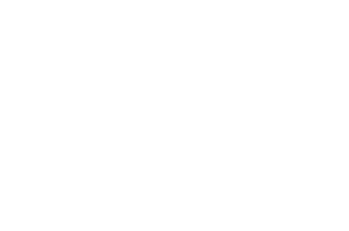

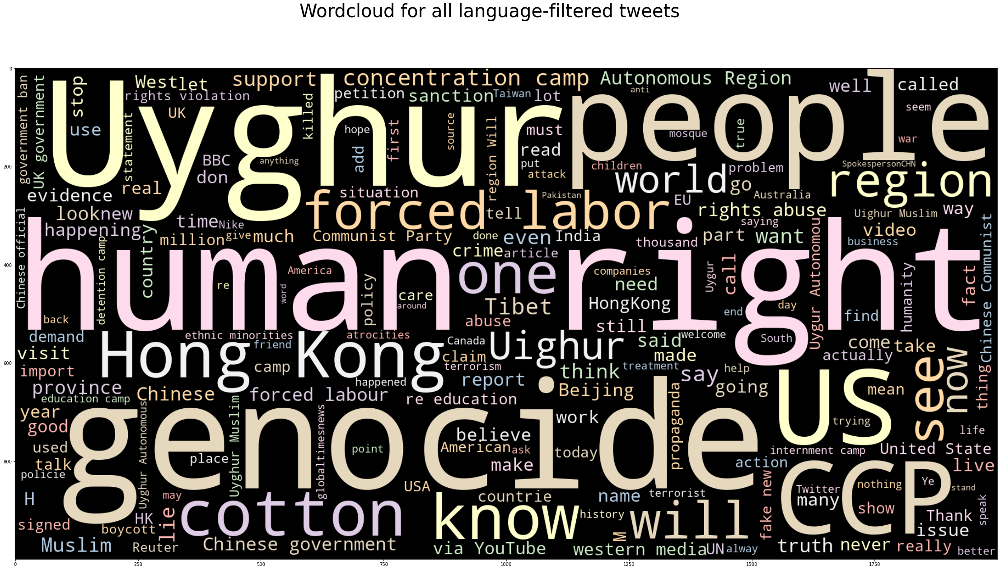

In [61]:
## wordcloud for all en, zh and und tweets
# create string
text = " ".join(tweet for tweet in tweets_en.tweet.astype(str))

# Create stopword list:
# remove words that we want to exclude

stopwords = set(STOPWORDS)
stopwords.update(["https", "t", "co", "amp", "U", "S", "Xinjiang", "China"])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(text)

# Display the generated image:

plt.axis("off")
plt.figure(figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for all language-filtered tweets', fontsize=40)
plt.show()

wordcloud.to_file("Graphs/filtered_overall_wordcloud.png")
#exported

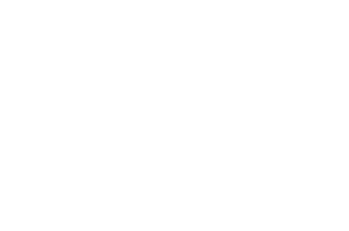

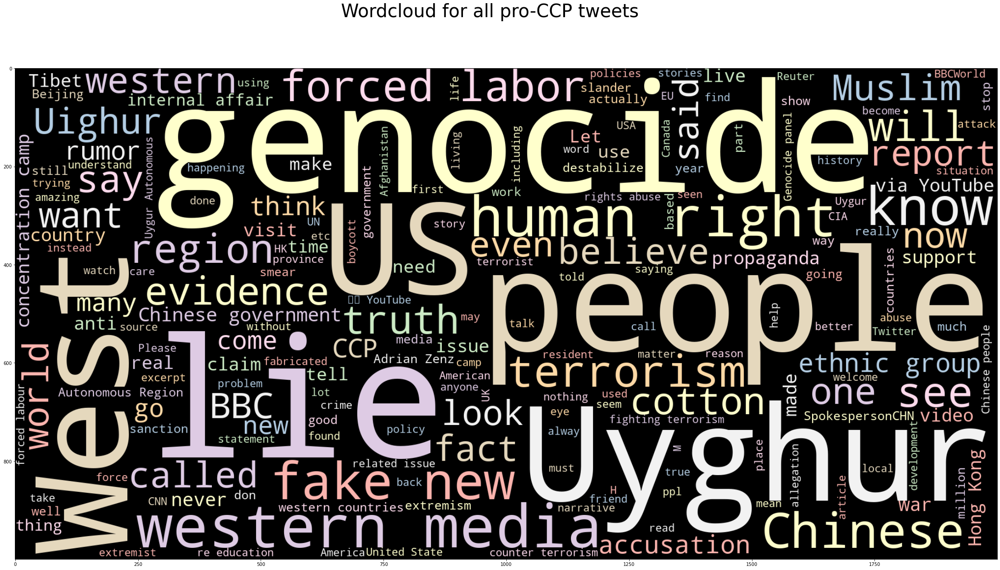

In [62]:
## wordcloud for all pro-CCP tweets
# create string
text = " ".join(tweet for tweet in pro_ccp_tweets.tweet.astype(str))

# Create stopword list:
# remove words that we want to exclude

stopwords = set(STOPWORDS)
stopwords.update(["https", "t", "co", "amp", "U", "S", "Xinjiang", "China"])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(text)

# Display the generated image:

plt.axis("off")
plt.figure(figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for all pro-CCP tweets', fontsize=40)
plt.show()

# a little redundant because we defined this group of tweets based on keywords that we chose, so no major surprises

wordcloud.to_file("Graphs/filtered_pro_wordcloud.png")
#exported

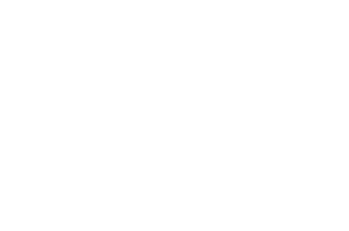

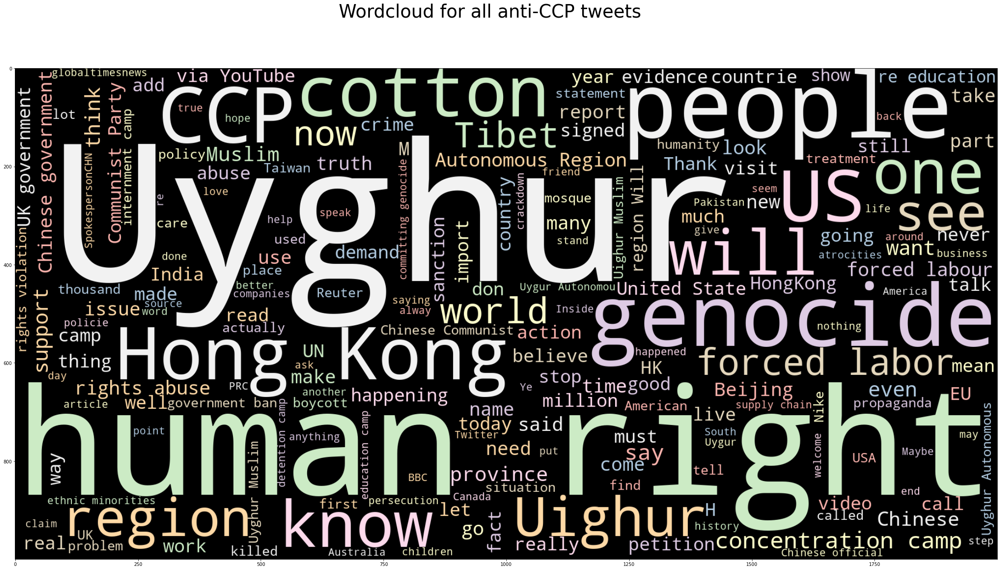

In [63]:
## wordcloud for all anti-CCP tweets
# create string
text = " ".join(tweet for tweet in anti_ccp_tweets.tweet.astype(str))

# Create stopword list:
# remove words that we want to exclude

stopwords = set(STOPWORDS)
stopwords.update(["https", "t", "co", "amp", "U", "S", "Xinjiang", "China"])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="black", colormap="Pastel1", width=2000, height=1000).generate(text)

# Display the generated image:

plt.axis("off")
plt.figure(figsize=(40,20))
plt.tight_layout(pad=0)
plt.imshow(wordcloud, interpolation='bilinear')
plt.suptitle('Wordcloud for all anti-CCP tweets', fontsize=40)
plt.show()

# Hong Kong and Tibet appear here, evidence of activity across China-related causes/movements

wordcloud.to_file("Graphs/filtered_anti_wordcloud.png")
#exported

## Sentiment analysis for pro- and anti-CCP

In [75]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
analyzer = SentimentIntensityAnalyzer()

In [83]:
# create 4 columns showing the 'positive', 'negative', 'neutral' and 'compound' sentiment scores for each tweet
tweets_en['compound'] = [analyzer.polarity_scores(x)['compound'] for x in tweets_en['tweet']]
tweets_en['neg'] = [analyzer.polarity_scores(x)['neg'] for x in tweets_en['tweet']]
tweets_en['neu'] = [analyzer.polarity_scores(x)['neu'] for x in tweets_en['tweet']]
tweets_en['pos'] = [analyzer.polarity_scores(x)['pos'] for x in tweets_en['tweet']]

# bunch of warnings popping up, but it seems to work fine?

<ipython-input-83-c32517fd4701>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-83-c32517fd4701>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-83-c32517fd4701>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-83-c32517f

In [66]:
# check the columns are generated
tweets_en.head()

,id,conversation_id,created_at,date,time,timezone,user_id,username,name,place,...,translate,trans_src,trans_dest,state_affiliated,pro_ccp,pro_ccp_str,compound,neg,neu,pos
0,1387557166614253569,1387557166614253569,2021-04-28 19:59:42 EDT,2021-04-28,19:59:42,-400,2321771780,hellsitehater,CCCP died for p'zones,NaN,...,NaN,NaN,NaN,False,True,Pro-CCP,0.1901,0.133,0.739,0.128
1,1387557144388534274,1387474787711209472,2021-04-28 19:59:37 EDT,2021-04-28,19:59:37,-400,1041324591136665600,missrinaelia,🤍,NaN,...,NaN,NaN,NaN,False,False,Anti-CCP,-0.0875,0.092,0.781,0.128
2,1387557056174043141,1387474787711209472,2021-04-28 19:59:16 EDT,2021-04-28,19:59:16,-400,1270834518606467072,badchinatake,Bad China Takes,NaN,...,NaN,NaN,NaN,False,False,Anti-CCP,0.7351,0.088,0.712,0.201
3,1387556813109932032,1387532220898893827,2021-04-28 19:58:18 EDT,2021-04-28,19:58:18,-400,4581444372,justkevooo,someone's burner account,NaN,...,NaN,NaN,NaN,False,False,Anti-CCP,-0.6868,0.102,0.869,0.028
6,1387556192306663424,1386594042515910660,2021-04-28 19:55:50 EDT,2021-04-28,19:55:50,-400,1283663270176452613,percept13233744,Perception,NaN,...,NaN,NaN,NaN,False,False,Anti-CCP,0.1280,0.041,0.907,0.051


In [67]:
# summary stats
sentiment = tweets_en.groupby(['pro_ccp'])[['compound', 'neg', 'neu', 'pos']].mean().unstack().reset_index()
sentiment

# pro-CCP is more negative than anti-CCP

,level_0,pro_ccp,0
0,compound,False,-0.059345
1,compound,True,-0.223313
2,neg,False,0.088156
3,neg,True,0.136302
4,neu,False,0.837628
5,neu,True,0.791755
6,pos,False,0.074213
7,pos,True,0.071937


In [68]:
tweets_en['pro_ccp_str'] = "Anti-CCP"
tweets_en.loc[tweets_en['pro_ccp'] == True, 'pro_ccp_str'] = "Pro-CCP"

# graph comparing sentiments
fig = px.bar(tweets_en.groupby('pro_ccp_str')['compound'].mean(),
            labels=dict(pro_ccp_str="Tweets Categorized by Pro and Anti CCP", value="Compound Sentiment Score"),
            title="Sentiment of Pro and Anti CCP Tweets")
fig.layout.update(showlegend = False)

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/sentiment_analysis_overall.png", scale=5)
#exported

<ipython-input-68-0e3e4a699e47>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/joshualam/opt/anaconda3/lib/python3.8/site-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Bubble Graphs

In [69]:
tweets_1000 = tweets_en[tweets_en['retweets_count'] > 1000]

In [70]:
fig = px.scatter(tweets_1000, x="date", y="compound",
                 size="retweets_count", color="pro_ccp",
                 hover_name='username', title = 'Tweets with More than 1000 Retweets Mapped by Sentiment Score', size_max=60)

fig.layout.template = 'plotly_dark'
fig.show()

fig.write_image("Graphs/sentiment_bubbles.png", scale=5)
#exported

In [71]:
fig = px.scatter(tweets_en, x="retweets_count", y="compound",
                 color="pro_ccp",
                 hover_name='username', title = 'Tweets Mapped by Sentiment Score and Number of Retweets', size_max=60)

fig.layout.template = 'plotly_dark'
fig.show()

#lol

#not exported

In [85]:
pro_xinjiang_df = pro_ccp_tweets[pro_ccp_tweets["hashtags"].str.contains("'xinjiang'")]
pro_xinjiang_df['compound'] = [analyzer.polarity_scores(x)['compound'] for x in pro_xinjiang_df['tweet']]

anti_xinjiang_df = anti_ccp_tweets[anti_ccp_tweets["hashtags"].str.contains("'xinjiang'")]
anti_xinjiang_df['compound'] = [analyzer.polarity_scores(x)['compound'] for x in anti_xinjiang_df['tweet']]

#is #xinjiang more positive for pro accounts

<ipython-input-85-e2d5770b4c9c>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-85-e2d5770b4c9c>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [91]:
pro_xinjiang_df['compound'].mean()


-0.19487184717500344

In [90]:
anti_xinjiang_df['compound'].mean()

#nope

-0.026769359536265535

## Image export package

In [1]:
!pip install kaleido